In [2]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import matplotlib.pyplot as plt
import seaborn as sns

In [3]:
import os

train_dir = r'C:\Users\vedik\Downloads\archive (1)\chest_xray\train'
val_dir = r'C:\Users\vedik\Downloads\archive (1)\chest_xray\val'
test_dir = r'C:\Users\vedik\Downloads\archive (1)\chest_xray\test'

# Just to verify:
print("Train contains:", os.listdir(train_dir))
print("Val contains:", os.listdir(val_dir))
print("Test contains:", os.listdir(test_dir))


Train contains: ['NORMAL', 'PNEUMONIA']
Val contains: ['NORMAL', 'PNEUMONIA']
Test contains: ['NORMAL', 'PNEUMONIA']


In [4]:
from keras.preprocessing.image import load_img, ImageDataGenerator
from PIL import Image
import cv2

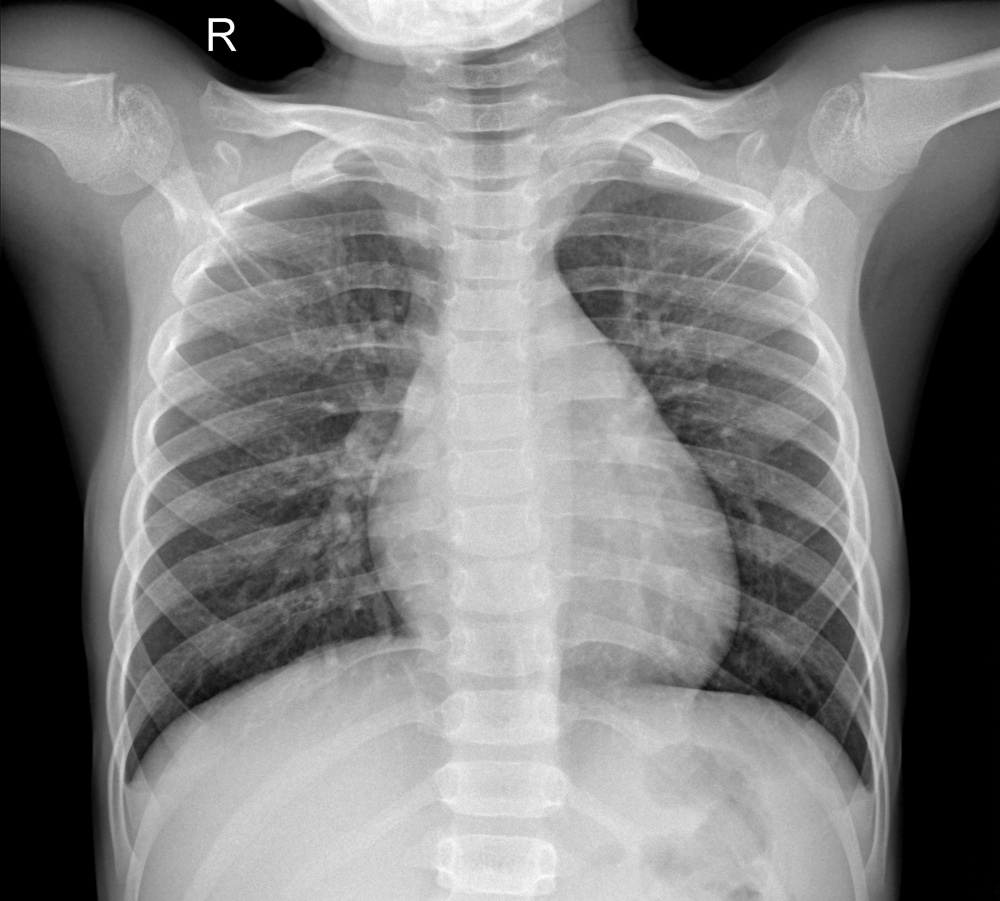

In [5]:
load_img(r'C:\Users\vedik\Downloads\archive (1)\chest_xray\train\NORMAL\IM-0143-0001.jpeg')

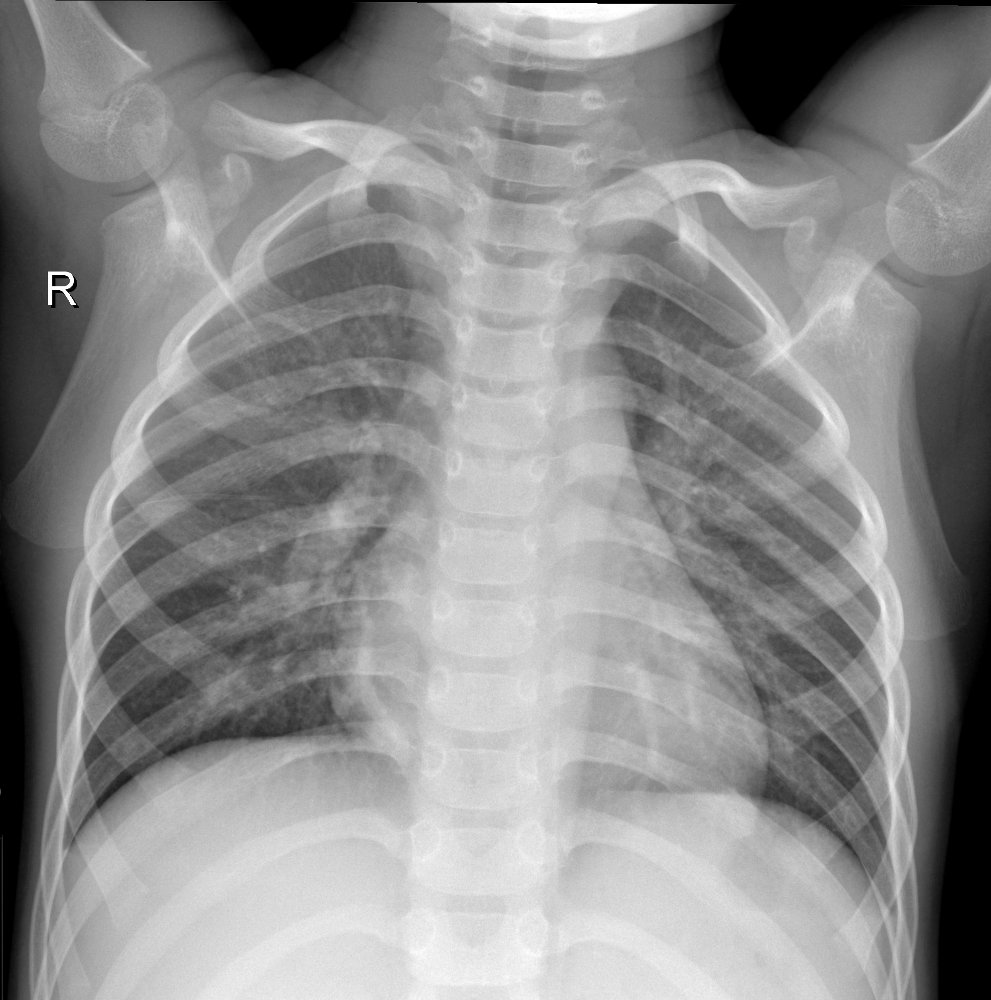

In [6]:
load_img(r'C:\Users\vedik\Downloads\archive (1)\chest_xray\train\NORMAL\IM-0172-0001.jpeg')

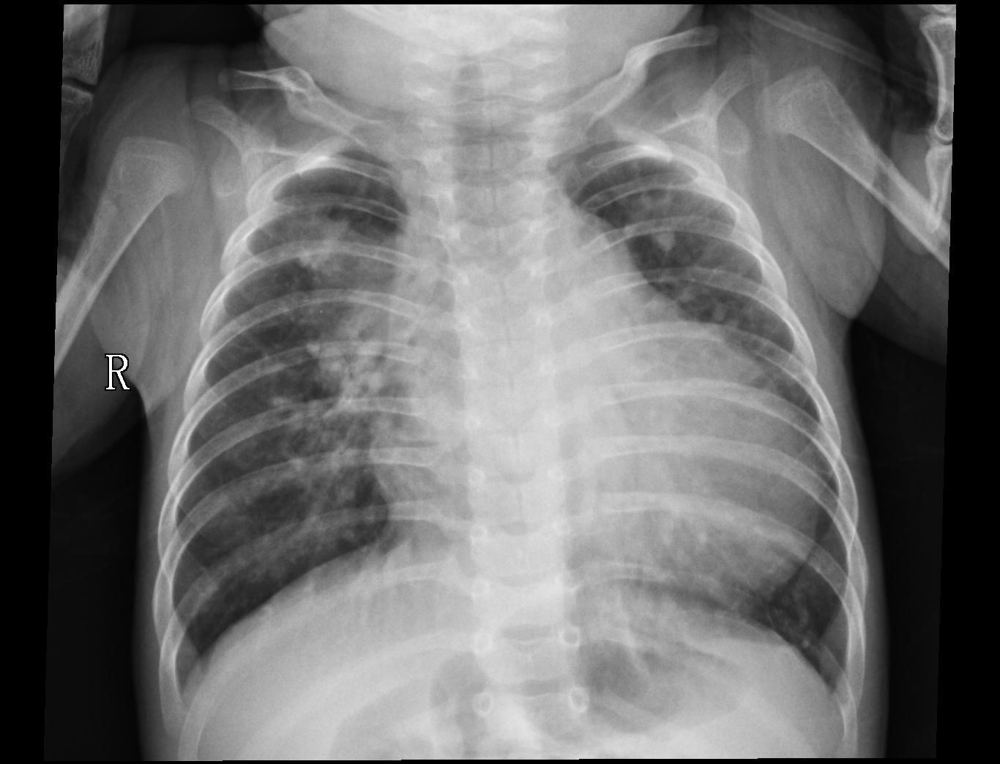

In [7]:
load_img(r'C:\Users\vedik\Downloads\archive (1)\chest_xray\train\PNEUMONIA\person1014_bacteria_2945.jpeg')

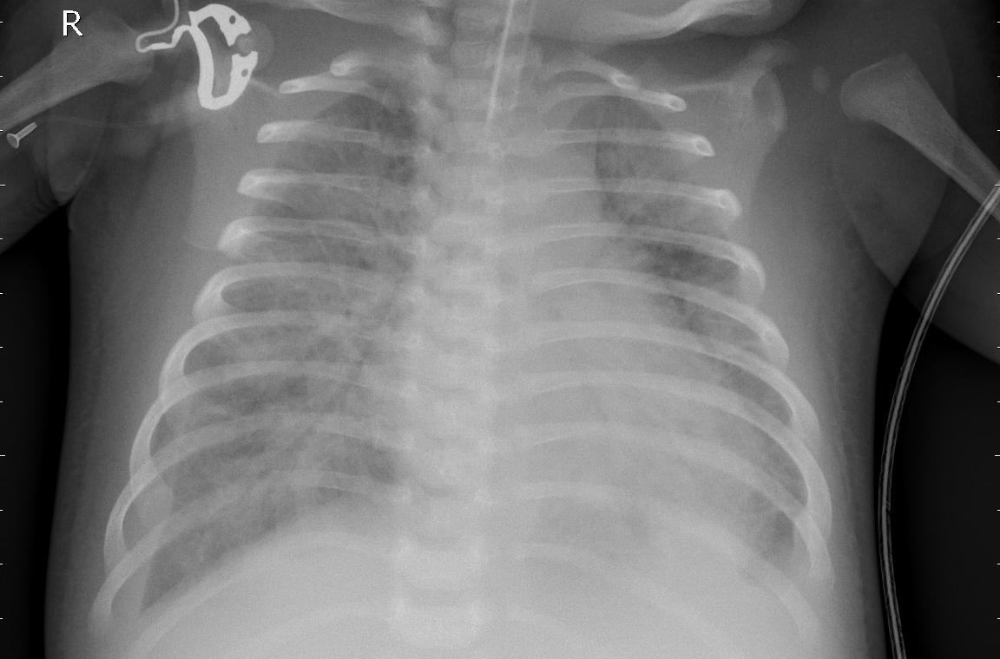

In [8]:
load_img(r'C:\Users\vedik\Downloads\archive (1)\chest_xray\train\PNEUMONIA\person1000_bacteria_2931.jpeg')

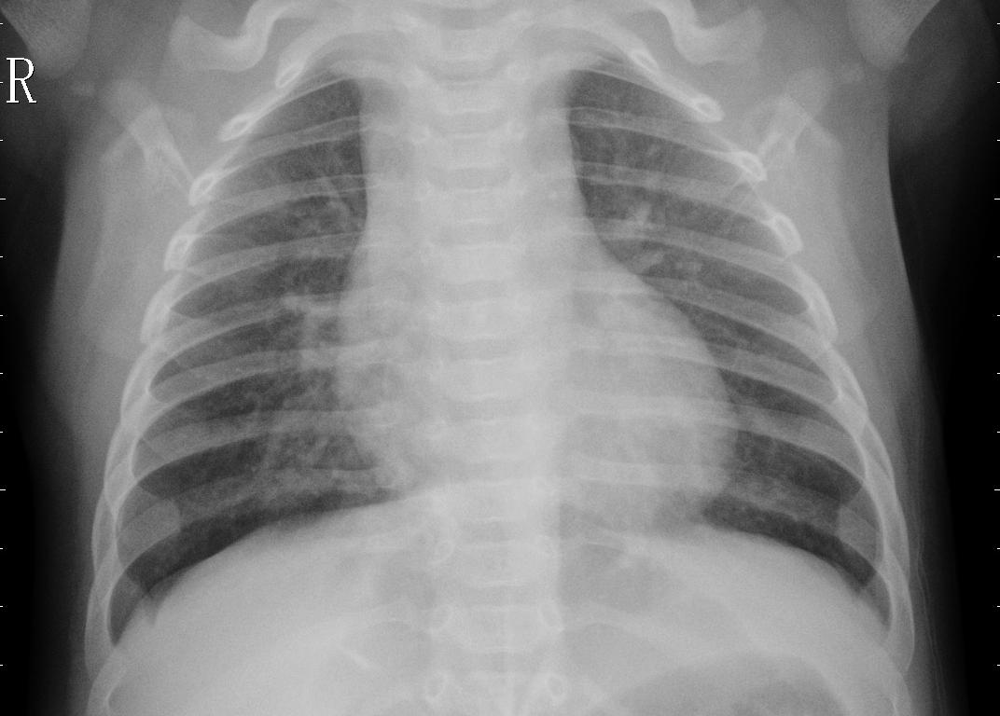

In [9]:
load_img(r'C:\Users\vedik\Downloads\archive (1)\chest_xray\train\PNEUMONIA\person1000_virus_1681.jpeg')

In [10]:
Image.open(r'C:\Users\vedik\Downloads\archive (1)\chest_xray\train\PNEUMONIA\person1000_bacteria_2931.jpeg').size

(1152, 760)

In [11]:
Image.open(r'C:\Users\vedik\Downloads\archive (1)\chest_xray\train\PNEUMONIA\person1015_virus_1701.jpeg').size

(1664, 1496)

In [12]:
Image.open(r'C:\Users\vedik\Downloads\archive (1)\chest_xray\train\NORMAL\IM-0128-0001.jpeg').size

(1528, 1013)

In [13]:
Image.open(r'C:\Users\vedik\Downloads\archive (1)\chest_xray\train\NORMAL\IM-0172-0001.jpeg').size

(1876, 1893)

In [14]:
img = cv2.imread(r'C:\Users\vedik\Downloads\archive (1)\chest_xray\train\NORMAL\IM-0172-0001.jpeg')

In [15]:
print(img.shape)

(1893, 1876, 3)


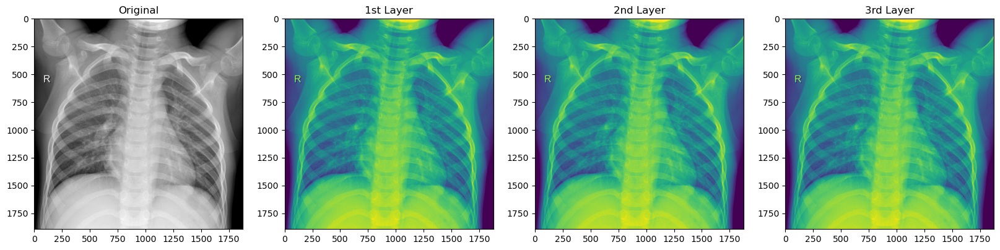

In [16]:
# DISPLAYING THE FIRST LAYER
fig, (ax1,ax2,ax3,ax4) = plt.subplots(nrows=1, ncols=4, figsize=(20,5))
ax1.imshow(img)
ax1.set_title('Original')

ax2.imshow(img[:, :, 0])
ax2.set_title('1st Layer')

ax3.imshow(img[:, :, 1])
ax3.set_title('2nd Layer')

ax4.imshow(img[:, :, 2])
ax4.set_title('3rd Layer');

In [17]:
print((img[:, :, 0] == img[:, :, 1]).all())
print((img[:, :, 0] == img[:, :, 2]).all())

True
True


In [18]:
import os
import glob
from pathlib import Path

In [19]:
# GET THE DIRECTORY TO THE DATASETS
path_data = r'C:\Users\vedik\Downloads\archive (1)\chest_xray'
path_train = os.path.join(path_data, 'train')
path_val = os.path.join(path_data, 'val')
path_test = os.path.join(path_data, 'test')

# INITIATE EMPTY LIST OF TRAINING DATA
# THAT WILL BE CONVERTED TO PANDAS DATAFRAME LATER
data_train = []
data_val = []
data_test = []
data = [data_train, data_val, data_test]

# ITERATE THROUGH EACH PATH
for i, d in enumerate([path_train, path_val, path_test]):
    # GET THE PATH TO EACH FOLDER - NORMAL AND PNEUMONIA
    normal = os.path.join(d, 'NORMAL')
    pneumonia = os.path.join(d, 'PNEUMONIA')
    
    # FETCH ALL .jpeg FILES
    normal_imgs = Path(normal).glob('*.jpeg')
    pneumonia_imgs = Path(pneumonia).glob('*.jpeg')
    
    # APPEND THE NAME AND CORRESPONDING LABEL (BASED ON FOLDER NAME)
    # TO data_train list AS TUPLES
    for img in normal_imgs:
        data[i].append((str(img), 0))
    
    for img in pneumonia_imgs:
        data[i].append((str(img), 1))

In [20]:
# CONVERT data_train TO DATAFRAME FOR EASY MANIPULATION
columns = ['image', 'label']
train_df = pd.DataFrame(data_train, columns=columns)
val_df = pd.DataFrame(data_val, columns=columns)
test_df = pd.DataFrame(data_test, columns=columns)

In [21]:
train_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5216 entries, 0 to 5215
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   image   5216 non-null   object
 1   label   5216 non-null   int64 
dtypes: int64(1), object(1)
memory usage: 81.6+ KB


In [22]:
train_df.label.value_counts()

label
1    3875
0    1341
Name: count, dtype: int64

In [23]:
val_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 16 entries, 0 to 15
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   image   16 non-null     object
 1   label   16 non-null     int64 
dtypes: int64(1), object(1)
memory usage: 388.0+ bytes


In [24]:
val_df.label.value_counts()

label
0    8
1    8
Name: count, dtype: int64

In [25]:
test_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 624 entries, 0 to 623
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   image   624 non-null    object
 1   label   624 non-null    int64 
dtypes: int64(1), object(1)
memory usage: 9.9+ KB


In [26]:
# CONCAT train_df and val_df
master_df = pd.concat([train_df, val_df])
# RESET INDEX (SO THERE WON'T BE ANY DUPLICATED INDICES) BY DROPPING OLD ONES
master_df.reset_index(inplace=True, drop=True)

In [27]:
master_df.tail(20)

,image,label
5212,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1
5213,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1
5214,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1
5215,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1
5216,C:\Users\vedik\Downloads\archive (1)\chest_xra...,0
5217,C:\Users\vedik\Downloads\archive (1)\chest_xra...,0
5218,C:\Users\vedik\Downloads\archive (1)\chest_xra...,0
5219,C:\Users\vedik\Downloads\archive (1)\chest_xra...,0
5220,C:\Users\vedik\Downloads\archive (1)\chest_xra...,0
5221,C:\Users\vedik\Downloads\archive (1)\chest_xra...,0


In [28]:
master_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5232 entries, 0 to 5231
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   image   5232 non-null   object
 1   label   5232 non-null   int64 
dtypes: int64(1), object(1)
memory usage: 81.9+ KB


In [29]:
# CHECK FOR DUPLICATES
master_df.duplicated().any()

False

In [30]:
master_df.sample(10, random_state=42)

,image,label
240,C:\Users\vedik\Downloads\archive (1)\chest_xra...,0
584,C:\Users\vedik\Downloads\archive (1)\chest_xra...,0
2259,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1
1420,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1
1835,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1
80,C:\Users\vedik\Downloads\archive (1)\chest_xra...,0
3859,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1
952,C:\Users\vedik\Downloads\archive (1)\chest_xra...,0
4431,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1
1260,C:\Users\vedik\Downloads\archive (1)\chest_xra...,0


In [31]:
master_df.label.value_counts()

label
1    3883
0    1349
Name: count, dtype: int64

In [32]:
master_df.label.value_counts(normalize=True)

label
1    0.742164
0    0.257836
Name: proportion, dtype: float64

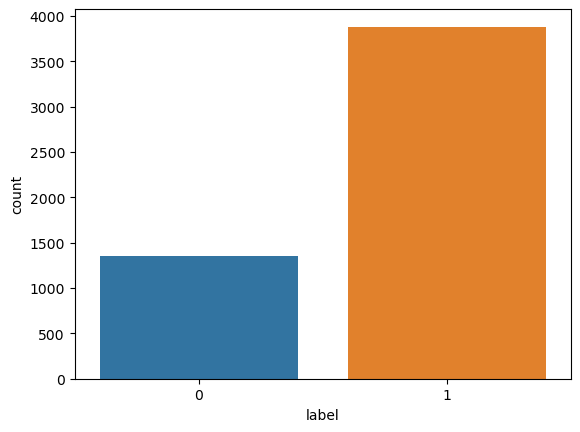

In [33]:
sns.countplot(x='label', data=master_df);

In [34]:
def cat_pneumonia_type(x):
    if 'bacteria' in x:
        output = 'bacteria'
    elif 'virus' in x:
        output = 'virus'
    else:
        output = 'normal'
    return output

In [35]:
master_df['type'] = master_df.image.apply(lambda x: cat_pneumonia_type(x))

In [36]:
master_df.type.value_counts()

type
bacteria    2538
normal      1349
virus       1345
Name: count, dtype: int64

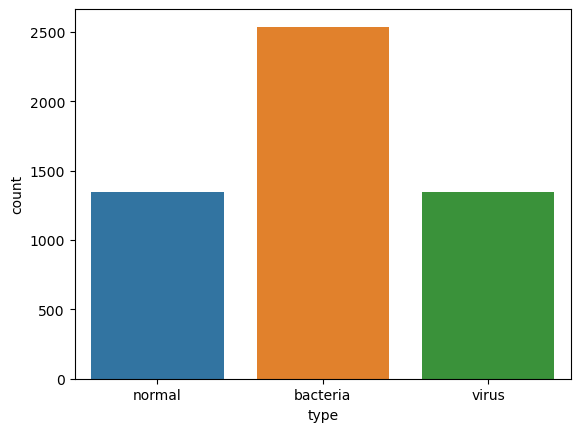

In [37]:
sns.countplot(x='type', data=master_df);

In [38]:
from sklearn.model_selection import train_test_split

In [39]:
# TRAIN VALIDATION SPLIT
train_df, val_df = train_test_split(master_df, test_size=0.2, random_state=42)

In [40]:
# MAKING SURE NONE OF THE SAMPLES IN val_df IS ALSO IN train_df
# TO AVOID DATA LEAKAGE
len(set(val_df.index) - set(train_df.index)) == len(val_df)

True

In [41]:
BATCH_SIZE = 32

# CREATE GENERATOR FOR TRAINING DATA (FROM train_df DATAFRAME)
train_generator = ImageDataGenerator(rescale=1.0/255).flow_from_dataframe(
    dataframe=train_df, x_col='image', y_col='label',
    color_mode='grayscale',
    class_mode='raw',
    target_size=(180,180), 
    batch_size=BATCH_SIZE,
    seed=42,
    shuffle=True   # shuffle so we're not missing out on any samples
)

# CREATE GENERATOR FOR VALIDATION DATA (FROM val_df DATAFRAME)
val_generator = ImageDataGenerator(rescale=1.0/255).flow_from_dataframe(
    dataframe=val_df, x_col='image', y_col='label',
    color_mode='grayscale',
    class_mode='raw',
    target_size=(180,180), 
    batch_size=BATCH_SIZE,
    seed=42,
    shuffle=True
)

Found 4185 validated image filenames.
Found 1047 validated image filenames.


In [42]:
# CHECKING THE SHAPE OF 1 BATCH OF THE train_generator
images_train, labels_train = next(train_generator)
print(f'Training set: {images_train.shape} | {labels_train.shape}')

Training set: (32, 180, 180, 1) | (32,)


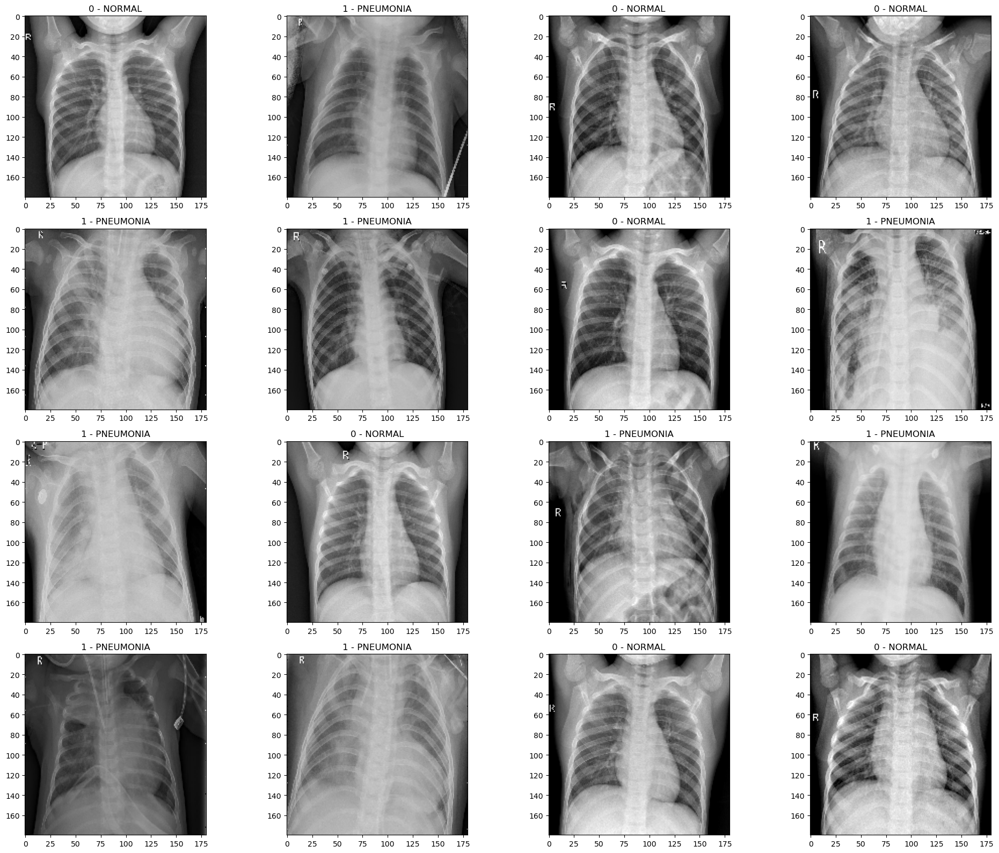

In [43]:
fig, axes = plt.subplots(nrows=4, ncols=4, figsize=(20,16))
label_output = {0: 'NORMAL', 1: 'PNEUMONIA'}
i = range(16)

for i in range(16):
    ax = axes[i // 4][i % 4]
    ax.imshow(images_train[i], cmap='gray')
    ax.set_title(f'{labels_train[i]} - {label_output[labels_train[i]]}')
    
plt.tight_layout()
plt.show();

In [44]:
from keras.models import Sequential, load_model
from keras.layers import Dense, Conv2D, Flatten, MaxPooling2D, Dropout
from keras.metrics import Recall, Precision
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from keras.callbacks import ModelCheckpoint, EarlyStopping
from keras.optimizers.schedules import ExponentialDecay

In [45]:
baseline = Sequential()
baseline.add(Conv2D(32, (3,3), activation='relu', padding='same',
               input_shape=[180,180,1]))
baseline.add(MaxPooling2D(pool_size=(2,2)))
baseline.add(Flatten())
baseline.add(Dense(32, activation='relu'))
baseline.add(Dense(1, activation='sigmoid'))

In [46]:
recall = Recall()
precision = Precision()

In [47]:
baseline.compile(loss='binary_crossentropy',
                 optimizer='adam',
                 metrics=['accuracy', recall, precision])

In [48]:
baseline.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 180, 180, 32)      320       
                                                                 
 max_pooling2d (MaxPooling2  (None, 90, 90, 32)        0         
 D)                                                              
                                                                 
 flatten (Flatten)           (None, 259200)            0         
                                                                 
 dense (Dense)               (None, 32)                8294432   
                                                                 
 dense_1 (Dense)             (None, 1)                 33        
                                                                 
Total params: 8294785 (31.64 MB)
Trainable params: 8294785 (31.64 MB)
Non-trainable params: 0 (0.00 Byte)
________________

In [49]:
checkpoint_cb = ModelCheckpoint('baseline.h5',
                                save_best_only=True)
early_stopping_cb = EarlyStopping(patience=10,
                                  restore_best_weights=True)

BATCH_SIZE = 32
EPOCHS = 30
print("Starting training...")

results_1 = baseline.fit(
    train_generator, 
    validation_data=val_generator,
    epochs=EPOCHS,
    steps_per_epoch=(train_generator.n // BATCH_SIZE),
    validation_steps=(val_generator.n // BATCH_SIZE),
    callbacks=[checkpoint_cb, early_stopping_cb],
    use_multiprocessing=False,   # <- FIXED HERE
    workers=8
)


Starting training...
Epoch 1/30


130/130 [==============================] - 41s 299ms/step - loss: 0.5179 - accuracy: 0.8406 - recall: 0.9687 - precision: 0.8417 - val_loss: 0.2778 - val_accuracy: 0.9473 - val_recall: 0.9676 - val_precision: 0.9598
Epoch 2/30


C:\Users\vedik\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


130/130 [==============================] - 26s 197ms/step - loss: 0.2253 - accuracy: 0.9439 - recall: 0.9894 - precision: 0.9389 - val_loss: 0.2321 - val_accuracy: 0.9600 - val_recall: 0.9609 - val_precision: 0.9834
Epoch 3/30
130/130 [==============================] - 34s 256ms/step - loss: 0.1931 - accuracy: 0.9648 - recall: 0.9891 - precision: 0.9648 - val_loss: 0.1998 - val_accuracy: 0.9668 - val_recall: 0.9852 - val_precision: 0.9695
Epoch 4/30
130/130 [==============================] - 33s 252ms/step - loss: 0.1787 - accuracy: 0.9701 - recall: 0.9890 - precision: 0.9715 - val_loss: 0.1907 - val_accuracy: 0.9648 - val_recall: 0.9892 - val_precision: 0.9632
Epoch 5/30
130/130 [==============================] - 33s 250ms/step - loss: 0.1574 - accuracy: 0.9764 - recall: 0.9910 - precision: 0.9777 - val_loss: 0.1766 - val_accuracy: 0.9727 - val_recall: 0.9892 - val_precision: 0.9734
Epoch 6/30
130/130 [==============================] - 33s 251ms/step - loss: 0.1399 - accuracy: 0.9843 

In [50]:
# VISUALIZE MODEL PERFORMANCE
def visualize_training_results(results):
    history = results.history
    
    for m in ['loss', 'accuracy', 'precision', 'recall']:
        plt.figure(figsize=(15,5))
        plt.plot(history[m], label='Training', marker='o', color='blue')
        plt.plot(history[f'val_{m}'], label='Validation', marker='o', color='red')
        plt.xlabel('Epochs')
        plt.legend()
        plt.title(m.title())
    
    plt.show();

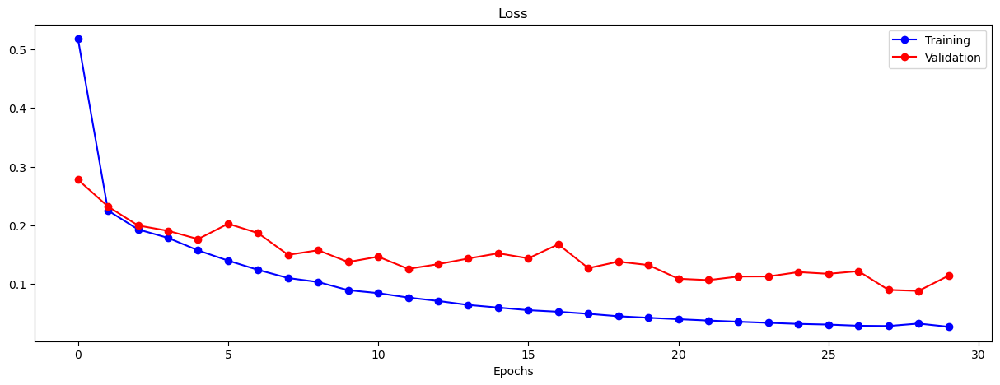

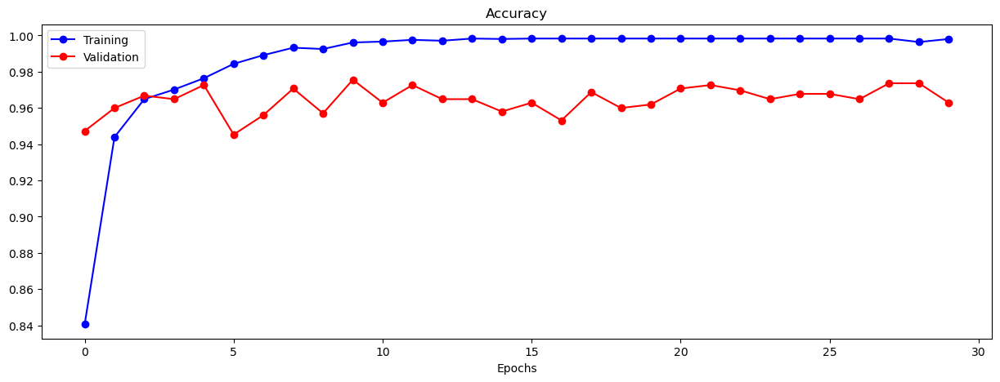

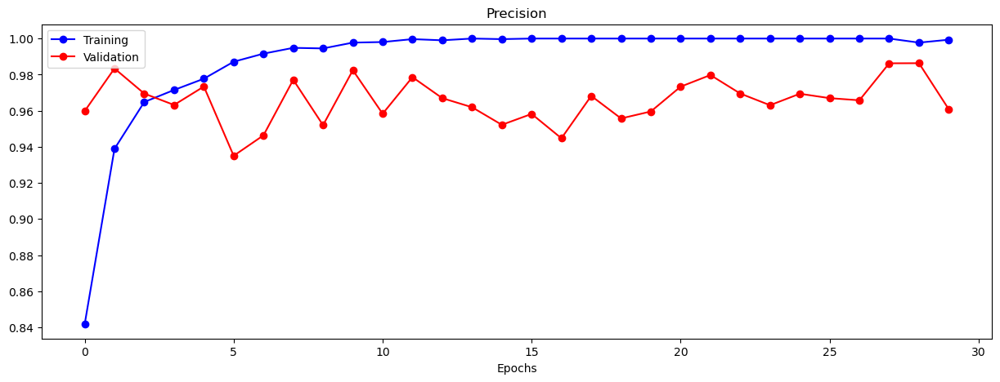

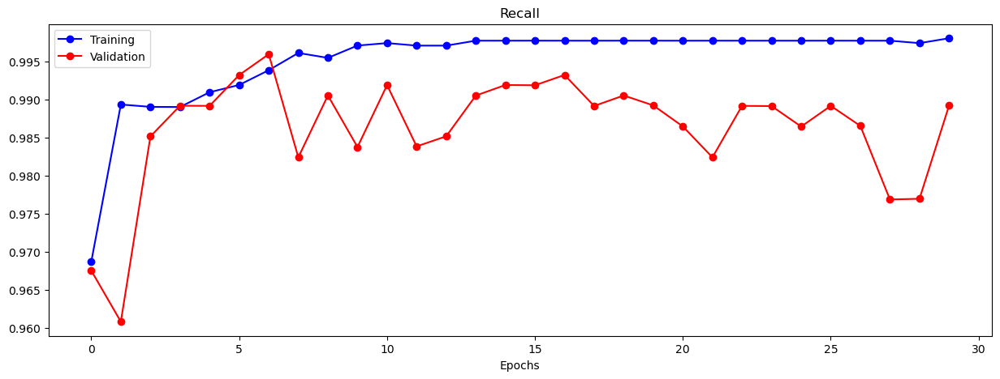

In [51]:
visualize_training_results(results_1)

In [52]:
# GENERATE PREDICTIONS ON TRAINING & VALIDATION DATA

# RECREATE GENERATORS FOR TRAINING & VALIDATION SET WITH shuffle = False
# IN ORDER TO PRESERVE THE ORDER OF THE IMAGES AND THEIR LABELS

train_eval_generator = ImageDataGenerator(rescale=1.0/255).flow_from_dataframe(
    dataframe=train_df, x_col='image', y_col='label',
    class_mode='raw',
    color_mode='grayscale',
    target_size=(180,180), batch_size=BATCH_SIZE,
    seed=2021,
    shuffle=False     # not shuffle so that the predicts come out in the same order as in the original dataset
)

val_eval_generator = ImageDataGenerator(rescale=1.0/255).flow_from_dataframe(
    dataframe=val_df, x_col='image', y_col='label',
    class_mode='raw',
    color_mode='grayscale',
    target_size=(180,180), batch_size=BATCH_SIZE,
    seed=2021,
    shuffle=False
)

# MAKE PREDICTIONS USING THE EVALUATION GENERATORS
preds_train_1 = baseline.predict(train_eval_generator, 
                                   steps=(train_generator.n//BATCH_SIZE+1), 
                                   verbose=1,
                                   workers=8)
preds_val_1 = baseline.predict(val_eval_generator, 
                                 steps=(val_generator.n//BATCH_SIZE+1),
                                 verbose=1,
                                 workers=8)

Found 4185 validated image filenames.
Found 1047 validated image filenames.
33/33 [==============================] - 2s 49ms/step


In [53]:
baseline_metrics = baseline.evaluate(val_eval_generator)
baseline_metrics

33/33 [==============================] - 6s 181ms/step - loss: 0.1134 - accuracy: 0.9628 - recall: 0.9894 - precision: 0.9603


[0.11337845027446747,
 0.9627507328987122,
 0.9894319772720337,
 0.9602563977241516]

In [54]:
# CREATE A DATAFRAME TO KEEP TRACK OF ALL MODELS PERFOMANCE ON VALIDATION SET
perf_df = pd.DataFrame(columns=['model', 'loss', 'accuracy', 'recall', 'precision'])

In [55]:
# APPEND BASELINE NUMBERS TO DATAFRAME
perf_df.loc[len(perf_df.index)] = ['baseline'] + baseline_metrics

In [56]:
perf_df

,model,loss,accuracy,recall,precision
0,baseline,0.113378,0.962751,0.989432,0.960256


In [57]:
def plot_confusionmatrix(y_true, y_pred):
    cm = confusion_matrix(y_true, y_pred)
    
    ax= plt.subplot()
    # annot=True to annotate cells, ftm='g' to disable scientific notation
    sns.heatmap(cm, annot=True, fmt='g', ax=ax)

    # labels, title and ticks
    ax.set_xlabel('Predicted labels')
    ax.set_ylabel('True labels')
    ax.set_title('Confusion Matrix')
    ax.xaxis.set_ticklabels(['NORMAL', 'PNEUMONIA'])
    ax.yaxis.set_ticklabels(['NORMAL', 'PNEUMONIA'])
    plt.show();

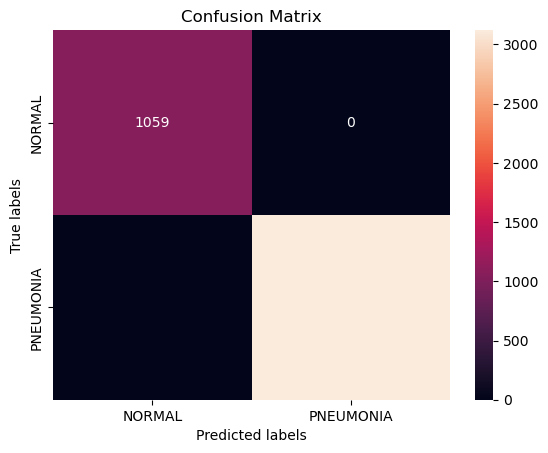

In [58]:
# PLOT CONFUSION MATRIX FOR TRAINING SET
# (converting predicted values from float to nearest integer)
plot_confusionmatrix(train_df['label'], np.rint(preds_train_1))  

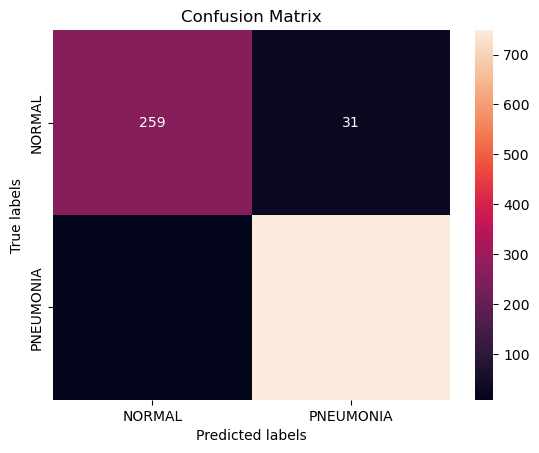

In [59]:
# PLOT CONFUSION MATRIX FOR VALIDATION SET
plot_confusionmatrix(val_df['label'], np.rint(preds_val_1))

In [60]:
val_df.label.value_counts()

label
1    757
0    290
Name: count, dtype: int64

In [61]:
748/757

0.988110964332893

In [62]:
# SAVE THE MODEL
baseline.save("baseline.h5")

C:\Users\vedik\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [63]:
import warnings
warnings.filterwarnings('ignore')

In [64]:
# APPEND PREDICTIONS OF THE BASELINE MODEL TO val_df FOR COMPARISON WITH
# OTHER MODELS LATER
val_df['baseline_pred'] = preds_val_1

# FALSE NEGATIVES BY BASELINE MODEL
# USING PROBABILITY THRESHOLD OF 0.5
fn = val_df[(val_df.label - np.rint(val_df.baseline_pred)) == 1]
fn

,image,label,type,baseline_pred
4849,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,virus,0.091200
3442,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,bacteria,0.220030
3869,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,virus,0.225899
1374,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,virus,0.103282
3697,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,bacteria,0.075713
4921,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,virus,0.075713
3142,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,virus,0.465354
1618,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,virus,0.098827


In [65]:
fn_generator = ImageDataGenerator(rescale=1.0/255).flow_from_dataframe(
    dataframe=fn, x_col='image', y_col='baseline_pred',
    class_mode='raw',
    color_mode='grayscale',
    target_size=(180,180), batch_size=BATCH_SIZE,
    shuffle=False
)

fn_images, fn_prob = next(fn_generator)

Found 8 validated image filenames.


False Negative Cases by Baseline Model using Probability Threshold = 0.5



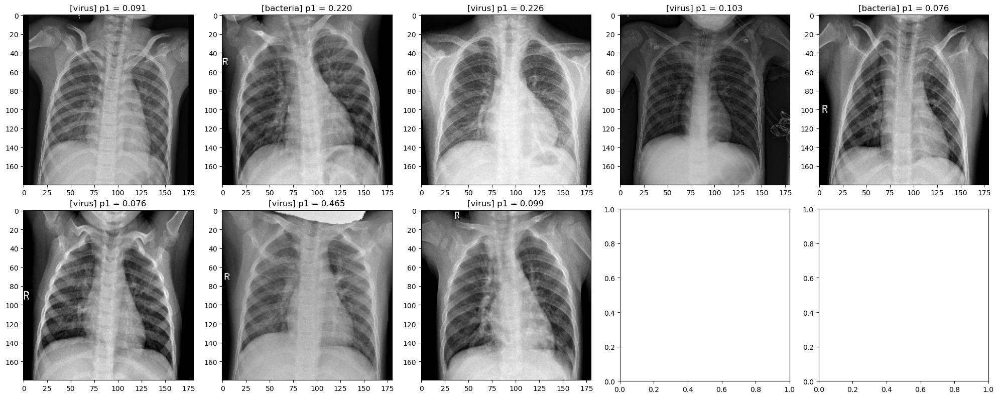

In [66]:
print('False Negative Cases by Baseline Model using Probability Threshold = 0.5')
print()
fig, axes = plt.subplots(nrows=2, ncols=5, figsize=(20,8))

for i in range(len(fn)):
    ax = axes[i // 5][i % 5]
    ax.imshow(fn_images[i], cmap='gray')
    ax.set_title('[{}] p1 = {:.3f}'.format(fn.iloc[i].type, fn_prob[i]))

plt.tight_layout()
plt.show();

In [67]:
fn.type.value_counts()

type
virus       6
bacteria    2
Name: count, dtype: int64

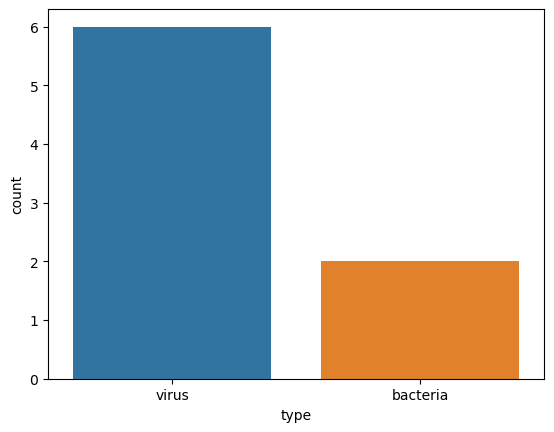

In [68]:
sns.countplot(x='type', data=fn);

In [69]:
cnn_2 = Sequential()
cnn_2.add(Conv2D(32, (3,3), activation='relu', padding='same',
               input_shape=[180,180,1]))
cnn_2.add(Conv2D(64, (3,3), activation='relu', padding='same'))
cnn_2.add(MaxPooling2D(pool_size=(2,2)))
cnn_2.add(Conv2D(128, (3,3), activation='relu', padding='same'))
cnn_2.add(MaxPooling2D(pool_size=(2,2)))
cnn_2.add(Flatten())
cnn_2.add(Dense(32, activation='relu'))
cnn_2.add(Dense(1, activation='sigmoid'))

In [70]:
cnn_2.compile(loss='binary_crossentropy',
              optimizer='adam',
              metrics=['accuracy', recall, precision])

cnn_2.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_1 (Conv2D)           (None, 180, 180, 32)      320       
                                                                 
 conv2d_2 (Conv2D)           (None, 180, 180, 64)      18496     
                                                                 
 max_pooling2d_1 (MaxPoolin  (None, 90, 90, 64)        0         
 g2D)                                                            
                                                                 
 conv2d_3 (Conv2D)           (None, 90, 90, 128)       73856     
                                                                 
 max_pooling2d_2 (MaxPoolin  (None, 45, 45, 128)       0         
 g2D)                                                            
                                                                 
 flatten_1 (Flatten)         (None, 259200)           

In [71]:
checkpoint_cb = ModelCheckpoint('cnn_2.h5',
                                save_best_only=True)
early_stopping_cb = EarlyStopping(patience=10,
                                  restore_best_weights=True)

BATCH_SIZE = 32
EPOCHS = 30

results_2 = cnn_2.fit(train_generator, 
                      validation_data=val_generator,
                      epochs=EPOCHS,
                      steps_per_epoch=(train_generator.n//BATCH_SIZE),
                      validation_steps=(val_generator.n//BATCH_SIZE),
                      callbacks=[checkpoint_cb, early_stopping_cb],
                      use_multiprocessing=False,
                      workers=8)

Epoch 1/30
130/130 [==============================] - 256s 2s/step - loss: 0.3335 - accuracy: 0.8700 - recall: 0.9570 - precision: 0.8994 - val_loss: 0.0986 - val_accuracy: 0.9619 - val_recall: 0.9650 - val_precision: 0.9822
Epoch 2/30
130/130 [==============================] - 682s 5s/step - loss: 0.1078 - accuracy: 0.9579 - recall: 0.9722 - precision: 0.9713 - val_loss: 0.1658 - val_accuracy: 0.9336 - val_recall: 0.9932 - val_precision: 0.9211
Epoch 3/30
130/130 [==============================] - 286s 2s/step - loss: 0.0762 - accuracy: 0.9750 - recall: 0.9819 - precision: 0.9845 - val_loss: 0.0839 - val_accuracy: 0.9688 - val_recall: 0.9838 - val_precision: 0.9733
Epoch 4/30
130/130 [==============================] - 285s 2s/step - loss: 0.0570 - accuracy: 0.9810 - recall: 0.9855 - precision: 0.9890 - val_loss: 0.2088 - val_accuracy: 0.9443 - val_recall: 0.9973 - val_precision: 0.9308
Epoch 5/30
130/130 [==============================] - 282s 2s/step - loss: 0.0470 - accuracy: 0.9851

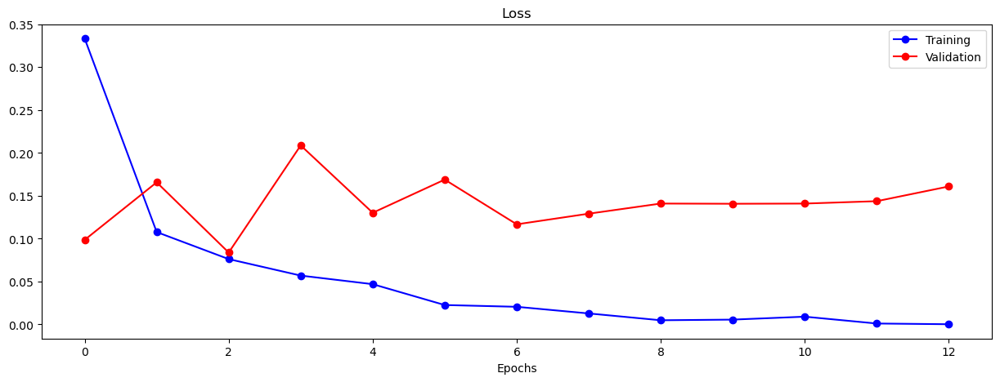

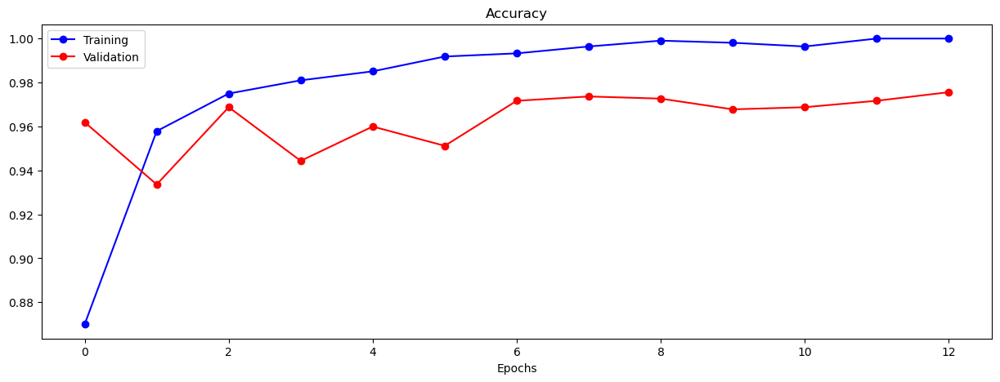

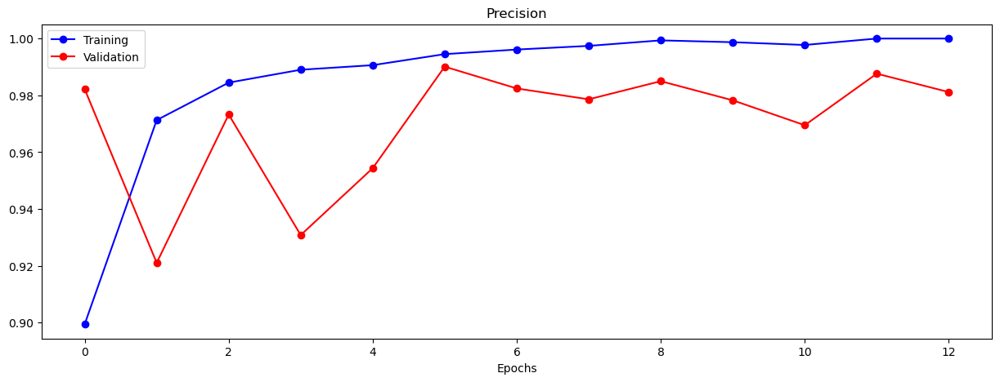

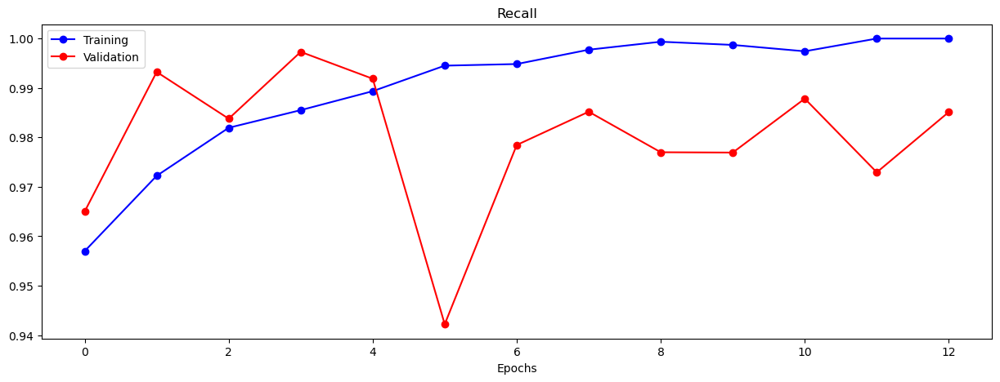

In [72]:
visualize_training_results(results_2)


In [73]:
# MAKE PREDICTIONS USING THE EVALUATION GENERATORS
preds_train_2 = cnn_2.predict(train_eval_generator, 
                                steps=(train_generator.n//BATCH_SIZE+1), 
                                verbose=1,
                                workers=8)
preds_val_2 = cnn_2.predict(val_eval_generator, 
                              steps=(val_generator.n//BATCH_SIZE+1),
                              verbose=1,
                              workers=8)

33/33 [==============================] - 14s 419ms/step


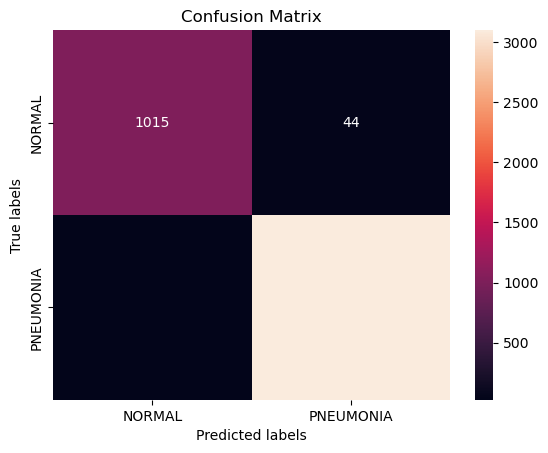

In [74]:
# PLOT CONFUSION MATRIX FOR TRAINING SET
# (converting predicted values from float to nearest integer)
plot_confusionmatrix(train_df['label'], np.rint(preds_train_2))  

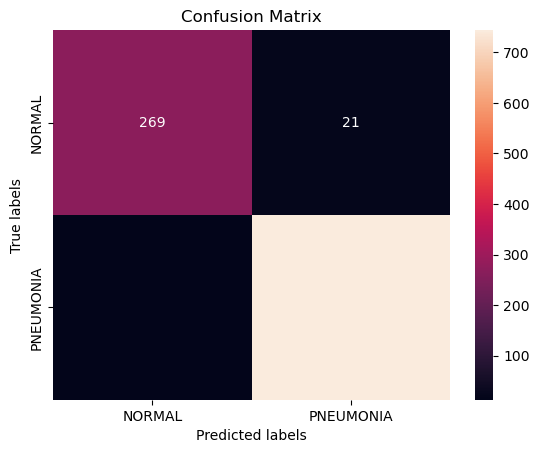

In [75]:
# PLOT CONFUSION MATRIX FOR VALIDATION SET
plot_confusionmatrix(val_df['label'], np.rint(preds_val_2))

In [76]:
cnn_2_metrics = cnn_2.evaluate(val_eval_generator)

33/33 [==============================] - 16s 485ms/step - loss: 0.0915 - accuracy: 0.9675 - recall: 0.9828 - precision: 0.9725


In [77]:
# APPEND BASELINE NUMBERS TO DATAFRAME
perf_df.loc[len(perf_df.index)] = ['cnn_2'] + cnn_2_metrics

In [78]:
perf_df

,model,loss,accuracy,recall,precision
0,baseline,0.113378,0.962751,0.989432,0.960256
1,cnn_2,0.091452,0.967526,0.982827,0.972549


In [79]:
# APPEND PREDICTIONS OF THE cnn_2 MODEL TO val_df FOR COMPARISON WITH
# OTHER MODELS LATER
val_df['cnn_2_pred'] = preds_val_2
val_df.head()

,image,label,type,baseline_pred,cnn_2_pred
240,C:\Users\vedik\Downloads\archive (1)\chest_xra...,0,normal,0.075713,0.017866
584,C:\Users\vedik\Downloads\archive (1)\chest_xra...,0,normal,0.075713,0.017516
2259,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,bacteria,1.000000,0.999284
1420,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,bacteria,1.000000,1.000000
1835,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,bacteria,1.000000,0.999970


In [80]:
# FALSE NEGATIVES BY cnn_2
fn2 = val_df[(val_df.label - np.rint(val_df.cnn_2_pred)) == 1]
fn2

,image,label,type,baseline_pred,cnn_2_pred
4849,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,virus,0.091200,0.491190
3226,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,virus,0.554254,0.217886
3442,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,bacteria,0.220030,0.261462
3869,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,virus,0.225899,0.422053
1374,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,virus,0.103282,0.250879
1666,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,virus,0.961141,0.091453
3697,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,bacteria,0.075713,0.148124
4993,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,virus,0.562928,0.432637
2366,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,virus,0.704200,0.131132
1669,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,virus,0.998887,0.269144


In [81]:
# PNEUMONIA CASES THAT HAVE BEEN INCORRECTLY PREDICTED BY baseline
fn1 = val_df[(val_df.label - np.rint(val_df.baseline_pred)) == 1]
fn1

,image,label,type,baseline_pred,cnn_2_pred
4849,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,virus,0.091200,0.491190
3442,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,bacteria,0.220030,0.261462
3869,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,virus,0.225899,0.422053
1374,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,virus,0.103282,0.250879
3697,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,bacteria,0.075713,0.148124
4921,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,virus,0.075713,0.026288
3142,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,virus,0.465354,0.815799
1618,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,virus,0.098827,0.170887


In [82]:
len(set(fn2.index) - set(fn1.index))

6

In [83]:
len(set(fn1.index) - set(fn2.index))

1

In [84]:
# PNEUMONIA CASES THAT HAVE BEEN INCORRECTLY PREDICTED BY BOTH MODELS
fn_both = val_df[((val_df.label - np.rint(val_df.baseline_pred)) == 1) & \
                 (np.rint(val_df.baseline_pred) == np.rint(val_df.cnn_2_pred))]
fn_both

,image,label,type,baseline_pred,cnn_2_pred
4849,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,virus,0.091200,0.491190
3442,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,bacteria,0.220030,0.261462
3869,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,virus,0.225899,0.422053
1374,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,virus,0.103282,0.250879
3697,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,bacteria,0.075713,0.148124
4921,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,virus,0.075713,0.026288
1618,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,virus,0.098827,0.170887


In [85]:
fn1.describe()

,label,baseline_pred,cnn_2_pred
count,8.0,8.000000,8.000000
mean,1.0,0.169502,0.323335
std,0.0,0.134359,0.248336
min,1.0,0.075713,0.026288
25%,1.0,0.087328,0.165196
50%,1.0,0.101055,0.256171
75%,1.0,0.221498,0.439338
max,1.0,0.465354,0.815799


In [86]:
fn_both.describe()

,label,baseline_pred,cnn_2_pred
count,7.0,7.000000,7.000000
mean,1.0,0.127238,0.252983
std,0.0,0.066249,0.160484
min,1.0,0.075713,0.026288
25%,1.0,0.083456,0.159505
50%,1.0,0.098827,0.250879
75%,1.0,0.161656,0.341758
max,1.0,0.225899,0.491190


In [87]:
print(fn_both.columns)
print([col for col in fn_both.columns])
print(fn_both['image'].head(5))


Index(['image', 'label', 'type', 'baseline_pred', 'cnn_2_pred'], dtype='object')
['image', 'label', 'type', 'baseline_pred', 'cnn_2_pred']
4849    C:\Users\vedik\Downloads\archive (1)\chest_xra...
3442    C:\Users\vedik\Downloads\archive (1)\chest_xra...
3869    C:\Users\vedik\Downloads\archive (1)\chest_xra...
1374    C:\Users\vedik\Downloads\archive (1)\chest_xra...
3697    C:\Users\vedik\Downloads\archive (1)\chest_xra...
Name: image, dtype: object


In [88]:
# DISPLAYING THE FALSE NEGATIVE CASES
fn_generator = ImageDataGenerator(rescale=1.0/255).flow_from_dataframe(
    dataframe=fn_both, x_col='image', y_col='cnn_2_pred',
    class_mode='raw',
    color_mode='grayscale',
    target_size=(180,180), batch_size=BATCH_SIZE,
    shuffle=False
)

fn_images, fn_prob = next(fn_generator)

Found 7 validated image filenames.


PNEUMONIA cases predicted as NORMAL by both models



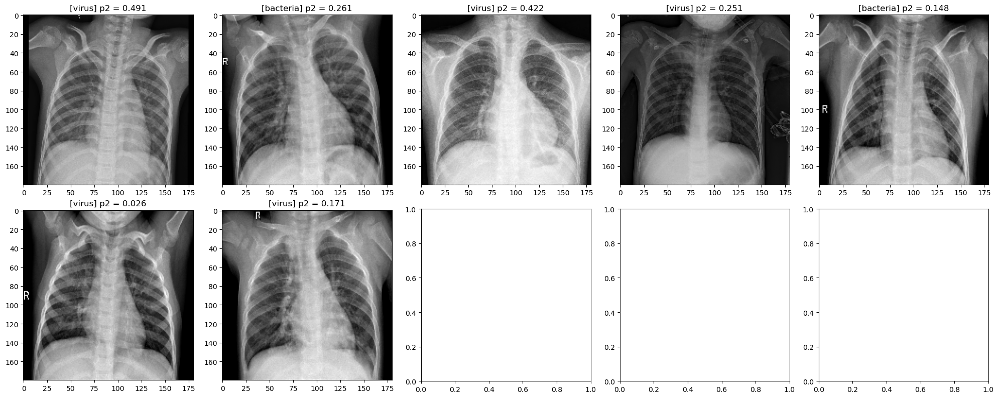

In [89]:
print('PNEUMONIA cases predicted as NORMAL by both models')
print()
fig, axes = plt.subplots(nrows=2, ncols=5, figsize=(20,8))

for i in range(len(fn_both)):
    ax = axes[i // 5][i % 5]
    ax.imshow(fn_images[i], cmap='gray')
    ax.set_title('[{}] p2 = {:.3f}'.format(fn_both.iloc[i].type, fn_prob[i]))

plt.tight_layout()
plt.show();

In [90]:
# SAVE THE MODEL
cnn_2.save("cnn_2.h5")

In [91]:
cnn_3 = Sequential()
cnn_3.add(Conv2D(32, (3,3), activation='relu', padding='same',
               input_shape=[180,180,1]))
cnn_3.add(MaxPooling2D(pool_size=(2,2)))
cnn_3.add(Flatten())
cnn_3.add(Dense(128, activation='relu'))
cnn_3.add(Dense(64, activation='relu'))
cnn_3.add(Dense(1, activation='sigmoid'))

In [92]:
cnn_3.compile(loss='binary_crossentropy',
              optimizer='adam',
              metrics=['accuracy', recall, precision])

cnn_3.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_4 (Conv2D)           (None, 180, 180, 32)      320       
                                                                 
 max_pooling2d_3 (MaxPoolin  (None, 90, 90, 32)        0         
 g2D)                                                            
                                                                 
 flatten_2 (Flatten)         (None, 259200)            0         
                                                                 
 dense_4 (Dense)             (None, 128)               33177728  
                                                                 
 dense_5 (Dense)             (None, 64)                8256      
                                                                 
 dense_6 (Dense)             (None, 1)                 65        
                                                      

In [93]:
checkpoint_cb = ModelCheckpoint('cnn_3.h5',
                                save_best_only=True)
early_stopping_cb = EarlyStopping(patience=10,
                                  restore_best_weights=True)

BATCH_SIZE = 32
EPOCHS = 30

results_3 = cnn_3.fit(train_generator, 
                      validation_data=val_generator,
                      epochs=EPOCHS,
                      steps_per_epoch=(train_generator.n//BATCH_SIZE),
                      validation_steps=(val_generator.n//BATCH_SIZE),
                      callbacks=[checkpoint_cb, early_stopping_cb],
                      use_multiprocessing=False,
                      workers=8)

Epoch 1/30
130/130 [==============================] - 51s 379ms/step - loss: 0.6816 - accuracy: 0.8469 - recall: 0.9233 - precision: 0.9050 - val_loss: 0.1396 - val_accuracy: 0.9502 - val_recall: 0.9434 - val_precision: 0.9873
Epoch 2/30
130/130 [==============================] - 59s 450ms/step - loss: 0.0853 - accuracy: 0.9706 - recall: 0.9826 - precision: 0.9782 - val_loss: 0.0861 - val_accuracy: 0.9668 - val_recall: 0.9879 - val_precision: 0.9670
Epoch 3/30
130/130 [==============================] - 50s 380ms/step - loss: 0.0411 - accuracy: 0.9868 - recall: 0.9919 - precision: 0.9904 - val_loss: 0.0680 - val_accuracy: 0.9746 - val_recall: 0.9743 - val_precision: 0.9904
Epoch 4/30
130/130 [==============================] - 48s 371ms/step - loss: 0.0162 - accuracy: 0.9954 - recall: 0.9971 - precision: 0.9968 - val_loss: 0.0677 - val_accuracy: 0.9736 - val_recall: 0.9852 - val_precision: 0.9786
Epoch 5/30
130/130 [==============================] - 47s 362ms/step - loss: 0.0111 - accura

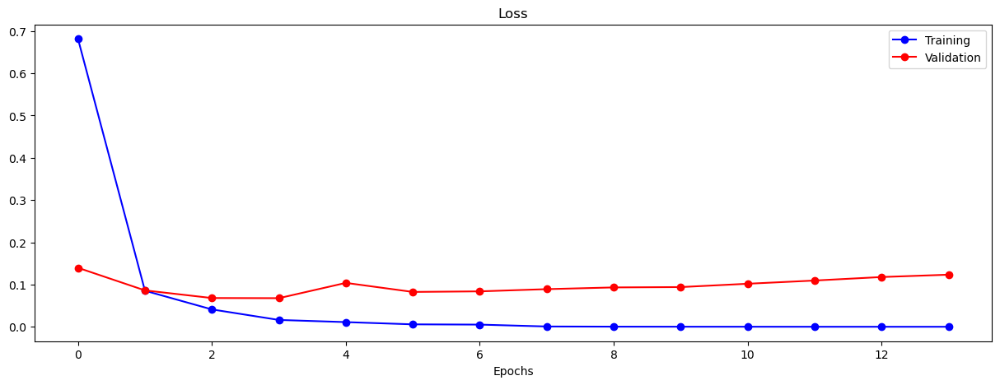

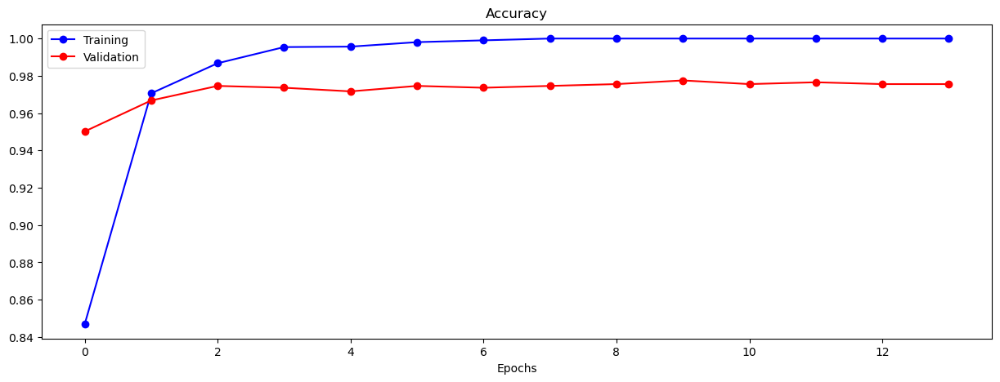

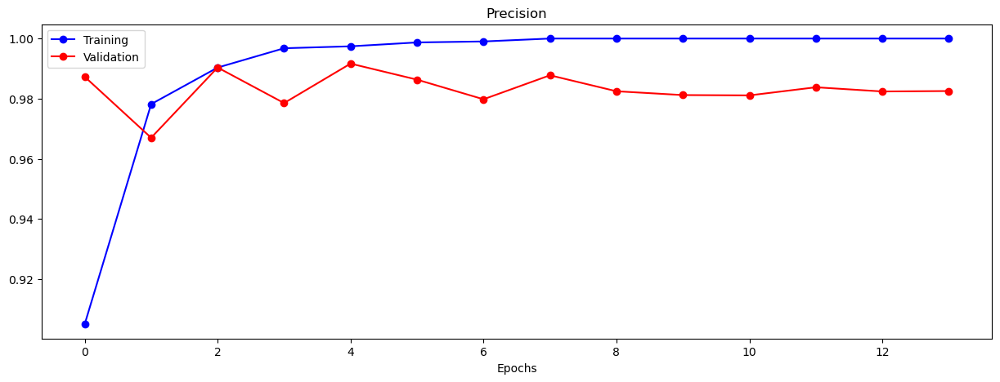

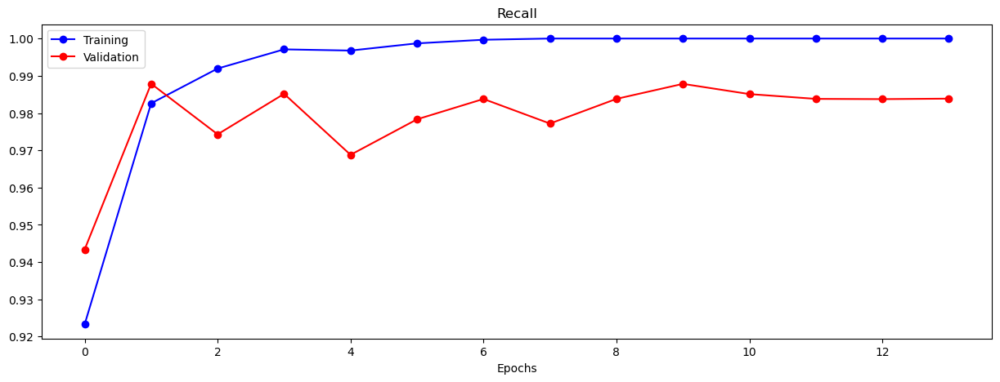

In [94]:
visualize_training_results(results_3)

In [95]:
# MAKE PREDICTIONS USING THE EVALUATION GENERATORS
preds_train_3 = cnn_3.predict(train_eval_generator, 
                                steps=(train_generator.n//BATCH_SIZE+1), 
                                verbose=1,
                                workers=8)
preds_val_3 = cnn_3.predict(val_eval_generator, 
                              steps=(val_generator.n//BATCH_SIZE+1),
                              verbose=1,
                              workers=8)

33/33 [==============================] - 2s 48ms/step


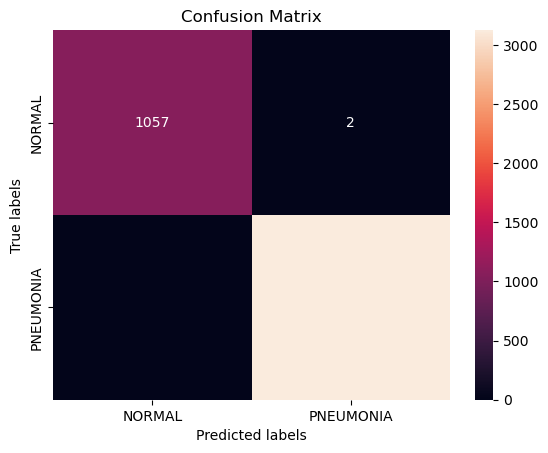

In [96]:
# PLOT CONFUSION MATRIX FOR TRAINING SET
# (converting predicted values from float to nearest integer)
plot_confusionmatrix(train_df['label'], np.rint(preds_train_3))  

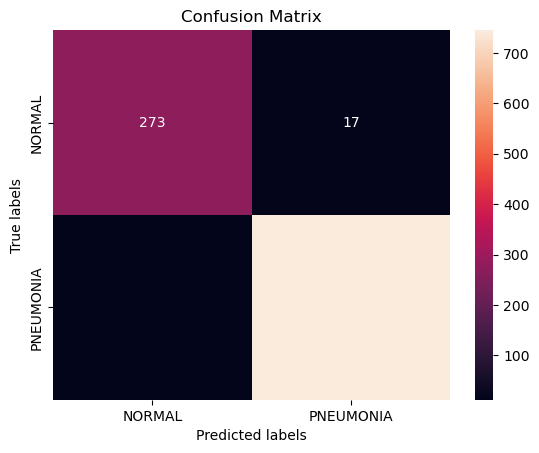

In [97]:
# PLOT CONFUSION MATRIX FOR VALIDATION SET
plot_confusionmatrix(val_df['label'], np.rint(preds_val_3))

In [98]:
cnn_3_metrics = cnn_3.evaluate(val_eval_generator)

33/33 [==============================] - 7s 207ms/step - loss: 0.0692 - accuracy: 0.9723 - recall: 0.9841 - precision: 0.9777


In [99]:
perf_df.loc[len(perf_df.index)] = ['cnn_3'] + cnn_3_metrics
perf_df

,model,loss,accuracy,recall,precision
0,baseline,0.113378,0.962751,0.989432,0.960256
1,cnn_2,0.091452,0.967526,0.982827,0.972549
2,cnn_3,0.069242,0.972302,0.984148,0.977690


In [100]:
# APPEND PREDICTIONS OF THE cnn_3 MODEL TO val_df FOR COMPARISON WITH
# OTHER MODELS LATER
val_df['cnn_3_pred'] = preds_val_3
val_df.head()

,image,label,type,baseline_pred,cnn_2_pred,cnn_3_pred
240,C:\Users\vedik\Downloads\archive (1)\chest_xra...,0,normal,0.075713,0.017866,0.000106
584,C:\Users\vedik\Downloads\archive (1)\chest_xra...,0,normal,0.075713,0.017516,0.000040
2259,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,bacteria,1.000000,0.999284,0.999990
1420,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,bacteria,1.000000,1.000000,1.000000
1835,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,bacteria,1.000000,0.999970,0.999993


In [101]:
# PNEUMONIA CASES THAT HAVE BEEN INCORRECTLY PREDICTED BY cnn_3
fn3 = val_df[(val_df.label - np.rint(val_df.cnn_3_pred)) == 1]
fn3

,image,label,type,baseline_pred,cnn_2_pred,cnn_3_pred
4431,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,virus,0.877712,0.603668,0.314154
3226,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,virus,0.554254,0.217886,0.457041
1351,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,bacteria,0.667925,0.738137,0.184882
3869,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,virus,0.225899,0.422053,0.398729
1374,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,virus,0.103282,0.250879,0.068678
1666,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,virus,0.961141,0.091453,0.362408
3697,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,bacteria,0.075713,0.148124,0.143118
2095,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,bacteria,0.878520,0.556208,0.400327
2366,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,virus,0.704200,0.131132,0.439241
4921,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,virus,0.075713,0.026288,0.002774


In [102]:
len(set(fn3.index) - set(fn1.index))

7

In [103]:
len(set(fn1.index) - set(fn3.index))

3

In [104]:
# SAVE THE MODEL
cnn_3.save("cnn_3.h5")

In [118]:
from sklearn.utils import class_weight

In [119]:
class_weights = class_weight.compute_class_weight('balanced',
                                                  classes=train_df['label'].unique(),
                                                  y=train_df['label'])

In [120]:
print(train_df['label'].unique())
print(class_weights)

[0 1]
[1.97592068 0.6693858 ]


In [121]:
class_weight = {0: class_weights[0], 1: class_weights[1]}
class_weight

{0: 1.9759206798866855, 1: 0.6693857965451055}

In [108]:
# RECONSTRUCT baseline WITH THE SAME ARCHITECTURE - CALLED cnn_4
cnn_4 = Sequential()
cnn_4.add(Conv2D(32, (3,3), activation='relu', padding='same',
               input_shape=[180,180,1]))
cnn_4.add(MaxPooling2D(pool_size=(2,2)))
cnn_4.add(Flatten())
cnn_4.add(Dense(32, activation='relu'))
cnn_4.add(Dense(1, activation='sigmoid'))

In [109]:
cnn_4.compile(loss='binary_crossentropy',
              optimizer='adam',
              metrics=['accuracy', recall, precision])

cnn_4.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_5 (Conv2D)           (None, 180, 180, 32)      320       
                                                                 
 max_pooling2d_4 (MaxPoolin  (None, 90, 90, 32)        0         
 g2D)                                                            
                                                                 
 flatten_3 (Flatten)         (None, 259200)            0         
                                                                 
 dense_7 (Dense)             (None, 32)                8294432   
                                                                 
 dense_8 (Dense)             (None, 1)                 33        
                                                                 
Total params: 8294785 (31.64 MB)
Trainable params: 8294785 (31.64 MB)
Non-trainable params: 0 (0.00 Byte)
______________

In [110]:
checkpoint_cb = ModelCheckpoint('cnn_4.h5',
                                save_best_only=True)
early_stopping_cb = EarlyStopping(patience=10,
                                  restore_best_weights=True)

BATCH_SIZE = 32
EPOCHS = 30

results_4 = cnn_4.fit(train_generator, 
                      validation_data=val_generator,
                      epochs=EPOCHS,
                      class_weight=class_weight,
                      steps_per_epoch=(train_generator.n//BATCH_SIZE),
                      validation_steps=(val_generator.n//BATCH_SIZE),
                      callbacks=[checkpoint_cb, early_stopping_cb])

Epoch 1/30
130/130 [==============================] - 52s 391ms/step - loss: 0.6364 - accuracy: 0.8370 - recall: 0.8611 - precision: 0.9516 - val_loss: 0.1431 - val_accuracy: 0.9492 - val_recall: 0.9419 - val_precision: 0.9873
Epoch 2/30
130/130 [==============================] - 49s 381ms/step - loss: 0.0987 - accuracy: 0.9656 - recall: 0.9636 - precision: 0.9901 - val_loss: 0.1081 - val_accuracy: 0.9629 - val_recall: 0.9556 - val_precision: 0.9930
Epoch 3/30
130/130 [==============================] - 49s 377ms/step - loss: 0.0592 - accuracy: 0.9810 - recall: 0.9794 - precision: 0.9951 - val_loss: 0.0782 - val_accuracy: 0.9697 - val_recall: 0.9743 - val_precision: 0.9836
Epoch 4/30
130/130 [==============================] - 50s 387ms/step - loss: 0.0433 - accuracy: 0.9856 - recall: 0.9833 - precision: 0.9974 - val_loss: 0.0943 - val_accuracy: 0.9619 - val_recall: 0.9932 - val_precision: 0.9558
Epoch 5/30
130/130 [==============================] - 50s 382ms/step - loss: 0.0378 - accura

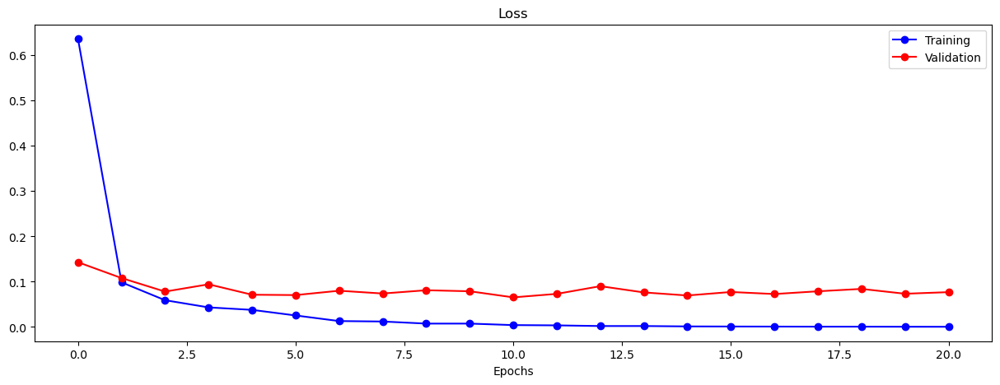

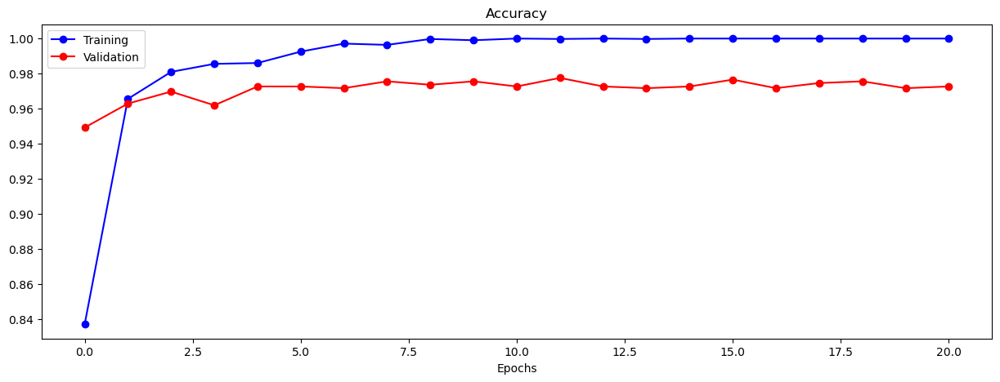

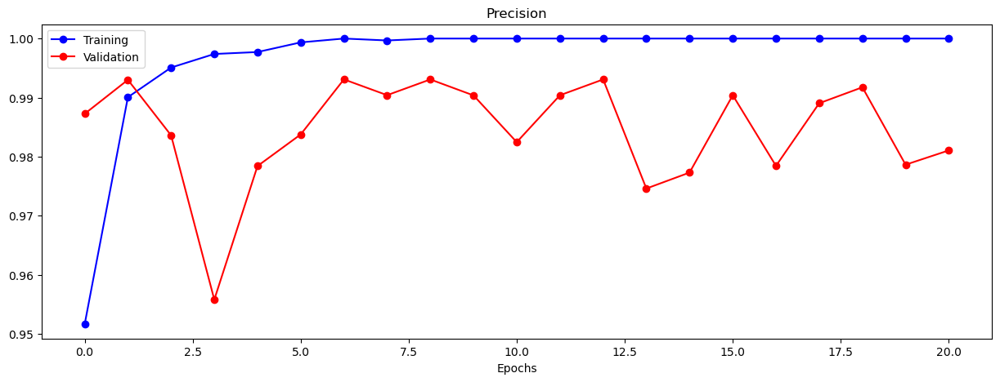

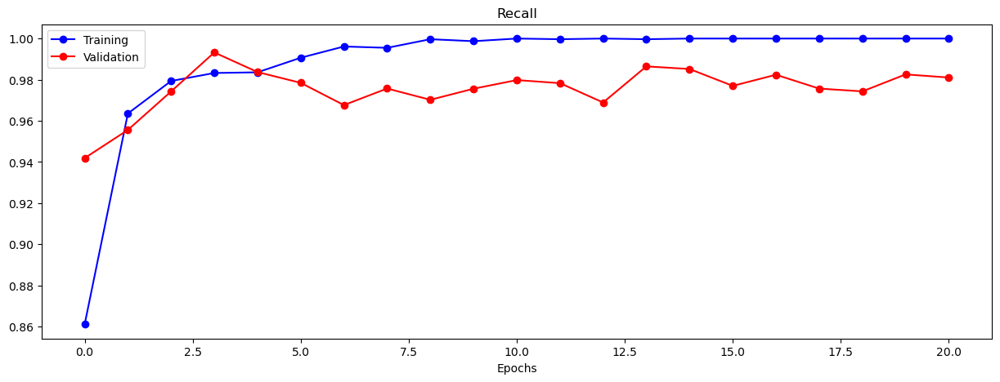

In [111]:
visualize_training_results(results_4)

In [112]:
# MAKE PREDICTIONS USING THE EVALUATION GENERATORS
preds_train_4 = cnn_4.predict(train_eval_generator, 
                           steps=(train_generator.n//BATCH_SIZE+1), 
                           verbose=1,
                           workers=8)
preds_val_4 = cnn_4.predict(val_eval_generator, 
                         steps=(val_generator.n//BATCH_SIZE+1),
                         verbose=1,
                         workers=8)

33/33 [==============================] - 2s 49ms/step


In [113]:
cnn_4_metrics = cnn_4.evaluate(val_eval_generator)

33/33 [==============================] - 6s 187ms/step - loss: 0.0674 - accuracy: 0.9713 - recall: 0.9789 - precision: 0.9815


In [114]:
perf_df.loc[len(perf_df.index)] = ['cnn_4'] + cnn_4_metrics
perf_df

,model,loss,accuracy,recall,precision
0,baseline,0.135636,0.966571,0.988111,0.966408
1,cnn_2,0.097508,0.965616,0.981506,0.971242
2,cnn_3,0.065743,0.973257,0.982827,0.980237
3,cnn_4,0.067421,0.971347,0.978864,0.981457


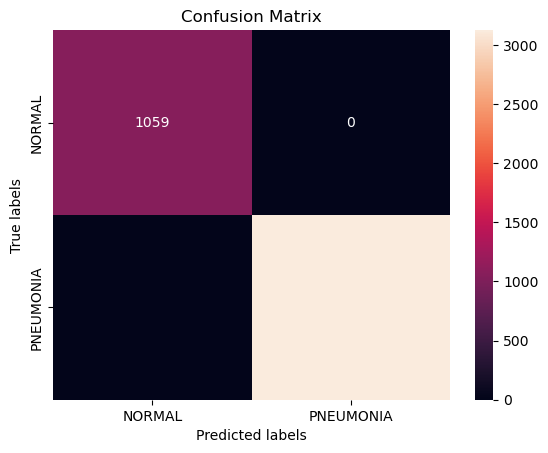

In [115]:
# PLOT CONFUSION MATRIX FOR TRAINING SET
# (converting predicted values from float to nearest integer)
plot_confusionmatrix(train_df['label'], np.rint(preds_train_4)) 

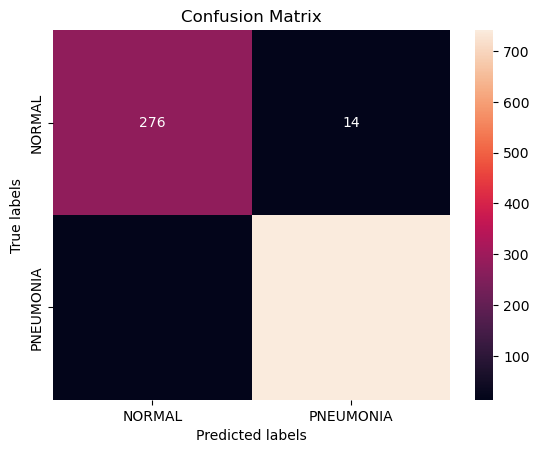

In [116]:
# PLOT CONFUSION MATRIX FOR VALIDATION SET
plot_confusionmatrix(val_df['label'], np.rint(preds_val_4))

In [117]:
# APPEND PREDICTIONS OF THE cnn_2 MODEL TO val_df FOR COMPARISON WITH
# OTHER MODELS LATER
val_df['cnn_4_pred'] = preds_val_4
val_df.head()

,image,label,type,baseline_pred,cnn_2_pred,cnn_3_pred,cnn_4_pred
240,C:\Users\vedik\Downloads\archive (1)\chest_xra...,0,normal,0.082106,0.004165,0.000584,0.000050
584,C:\Users\vedik\Downloads\archive (1)\chest_xra...,0,normal,0.082106,0.006905,0.000241,0.000027
2259,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,bacteria,1.000000,0.999843,0.999947,0.999986
1420,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,bacteria,1.000000,1.000000,1.000000,1.000000
1835,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,bacteria,1.000000,0.999963,0.999986,0.999997


In [118]:
# PNEUMONIA CASES THAT HAVE BEEN INCORRECTLY PREDICTED BY cnn_4
fn4 = val_df[(val_df.label - np.rint(val_df.cnn_4_pred)) == 1]
fn4

,image,label,type,baseline_pred,cnn_2_pred,cnn_3_pred,cnn_4_pred
4431,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,virus,0.691472,0.677841,0.310703,0.341446
4849,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,virus,0.916973,0.096904,0.559646,0.269886
3226,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,virus,0.137641,0.059667,0.440725,0.292428
3958,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,bacteria,0.894812,0.707255,0.557004,0.459291
3442,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,bacteria,0.499926,0.210230,0.340346,0.087276
1351,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,bacteria,0.449593,0.835255,0.443359,0.219194
3869,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,virus,0.082106,0.139956,0.437836,0.338730
1374,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,virus,0.212132,0.086999,0.071287,0.022252
1666,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,virus,0.886227,0.028001,0.468582,0.343539
3697,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,bacteria,0.233396,0.121542,0.121893,0.028041


In [119]:
# PNEUMONIA CASES THAT HAVE BEEN INCORRECTLY PREDICTED BY 3 MODELS baseline, cnn_3 and cnn_4
fn_all = val_df[((val_df.label - np.rint(val_df.baseline_pred)) == 1) & \
                (np.rint(val_df.baseline_pred) == np.rint(val_df.cnn_3_pred)) & \
                (np.rint(val_df.baseline_pred) == np.rint(val_df.cnn_4_pred))]
fn_all

,image,label,type,baseline_pred,cnn_2_pred,cnn_3_pred,cnn_4_pred
3226,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,virus,0.137641,0.059667,0.440725,0.292428
3442,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,bacteria,0.499926,0.210230,0.340346,0.087276
1351,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,bacteria,0.449593,0.835255,0.443359,0.219194
3869,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,virus,0.082106,0.139956,0.437836,0.338730
1374,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,virus,0.212132,0.086999,0.071287,0.022252
3697,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,bacteria,0.233396,0.121542,0.121893,0.028041
2366,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,virus,0.143797,0.160385,0.246908,0.228443
4921,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,virus,0.082106,0.008906,0.002666,0.000654
3199,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,bacteria,0.316936,0.073294,0.327532,0.268770


In [120]:
fn_generator = ImageDataGenerator(rescale=1.0/255).flow_from_dataframe(
    dataframe=fn_all, x_col='image', y_col='cnn_4_pred',
    class_mode='raw',
    color_mode='grayscale',
    target_size=(180,180), batch_size=BATCH_SIZE,
    shuffle=False
)

fn_images, fn_prob = next(fn_generator)

Found 9 validated image filenames.


PNEUMONIA cases predicted as NORMAL by 3 models baseline, cnn_3 and cnn_4



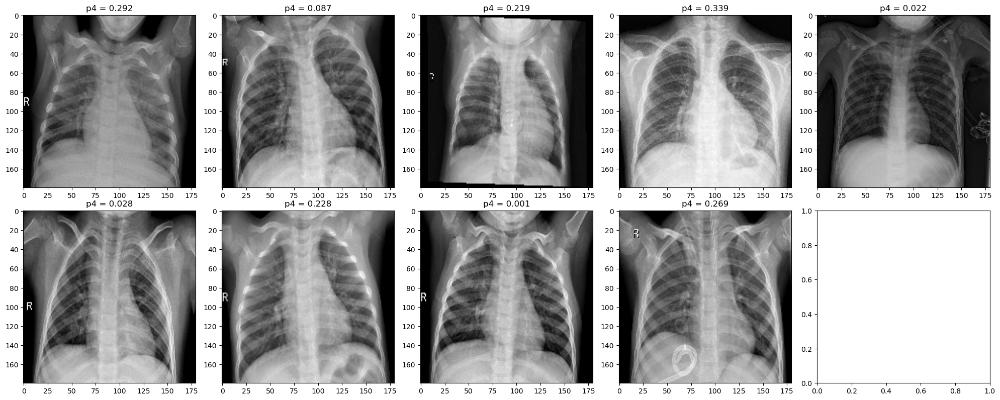

In [121]:
print('PNEUMONIA cases predicted as NORMAL by 3 models baseline, cnn_3 and cnn_4')
print()
fig, axes = plt.subplots(nrows=2, ncols=5, figsize=(20,8))

for i in range(len(fn_all)):
    ax = axes[i // 5][i % 5]
    ax.imshow(fn_images[i], cmap='gray')
    ax.set_title('p4 = {:.3f}'.format(fn_prob[i]))

plt.tight_layout()
plt.show();

In [122]:
# SAVE THE MODEL
cnn_4.save("cnn_4.h5")

In [123]:
# RECONSTRUCT cnn_4 WITH THE SAME ARCHITECTURE - called cnn_5
# ADDING 2 DROPOUT LAYERS
cnn_5 = Sequential()
cnn_5.add(Conv2D(32, (3,3), activation='relu', padding='same',
               input_shape=[180,180,1]))
cnn_5.add(MaxPooling2D(pool_size=(2,2)))
cnn_5.add(Flatten())
cnn_5.add(Dense(64, activation='relu'))
cnn_5.add(Dropout(0.3))
cnn_5.add(Dense(32, activation='relu'))
cnn_5.add(Dropout(0.3))
cnn_5.add(Dense(1, activation='sigmoid'))

In [124]:
cnn_5.compile(loss='binary_crossentropy',
              optimizer='adam',
              metrics=['accuracy', recall, precision])

cnn_5.summary()

Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_6 (Conv2D)           (None, 180, 180, 32)      320       
                                                                 
 max_pooling2d_5 (MaxPoolin  (None, 90, 90, 32)        0         
 g2D)                                                            
                                                                 
 flatten_4 (Flatten)         (None, 259200)            0         
                                                                 
 dense_9 (Dense)             (None, 64)                16588864  
                                                                 
 dropout (Dropout)           (None, 64)                0         
                                                                 
 dense_10 (Dense)            (None, 32)                2080      
                                                      

In [125]:
checkpoint_cb = ModelCheckpoint('cnn_5.h5',
                                save_best_only=True)
early_stopping_cb = EarlyStopping(patience=10,
                                  restore_best_weights=True)

BATCH_SIZE = 32
EPOCHS = 50

results_5 = cnn_5.fit(train_generator, 
                      validation_data=val_generator,
                      epochs=EPOCHS,
                      class_weight=class_weight,
                      steps_per_epoch=(train_generator.n//BATCH_SIZE),
                      validation_steps=(val_generator.n//BATCH_SIZE),
                      callbacks=[checkpoint_cb, early_stopping_cb])

Epoch 1/50
130/130 [==============================] - 60s 453ms/step - loss: 1.3784 - accuracy: 0.7373 - recall: 0.7948 - precision: 0.9031 - val_loss: 0.1902 - val_accuracy: 0.9404 - val_recall: 0.9607 - val_precision: 0.9568
Epoch 2/50
130/130 [==============================] - 59s 451ms/step - loss: 0.2637 - accuracy: 0.9054 - recall: 0.9130 - precision: 0.9584 - val_loss: 0.1982 - val_accuracy: 0.9209 - val_recall: 0.8905 - val_precision: 1.0000
Epoch 3/50
130/130 [==============================] - 56s 432ms/step - loss: 0.1890 - accuracy: 0.9359 - recall: 0.9374 - precision: 0.9758 - val_loss: 0.1681 - val_accuracy: 0.9395 - val_recall: 0.9159 - val_precision: 1.0000
Epoch 4/50
130/130 [==============================] - 55s 425ms/step - loss: 0.1360 - accuracy: 0.9511 - recall: 0.9513 - precision: 0.9827 - val_loss: 0.1423 - val_accuracy: 0.9482 - val_recall: 0.9312 - val_precision: 0.9971
Epoch 5/50
130/130 [==============================] - 54s 415ms/step - loss: 0.1006 - accura

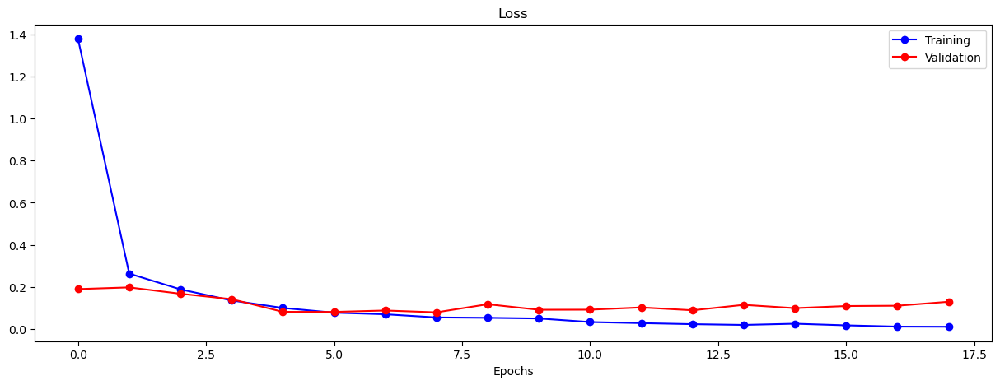

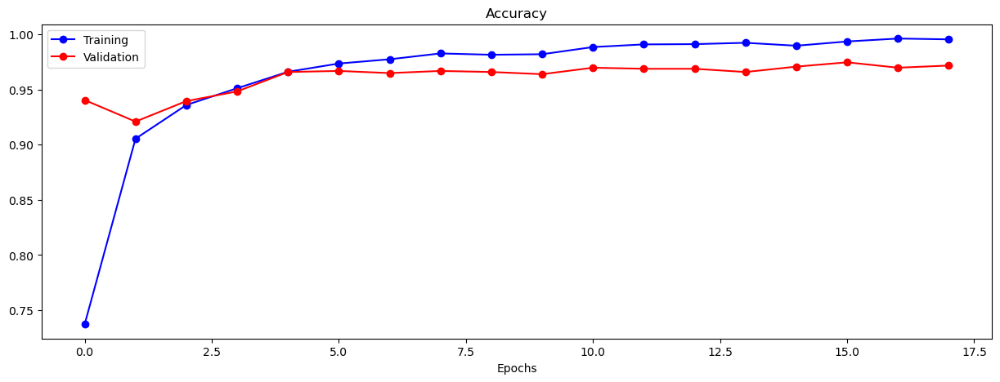

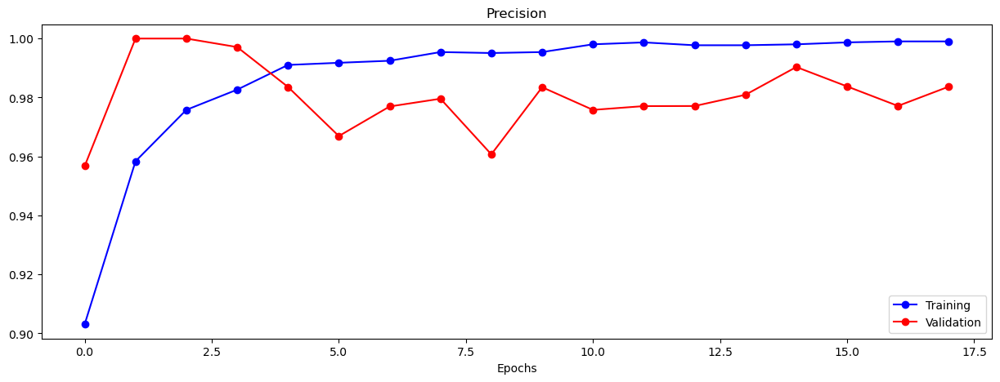

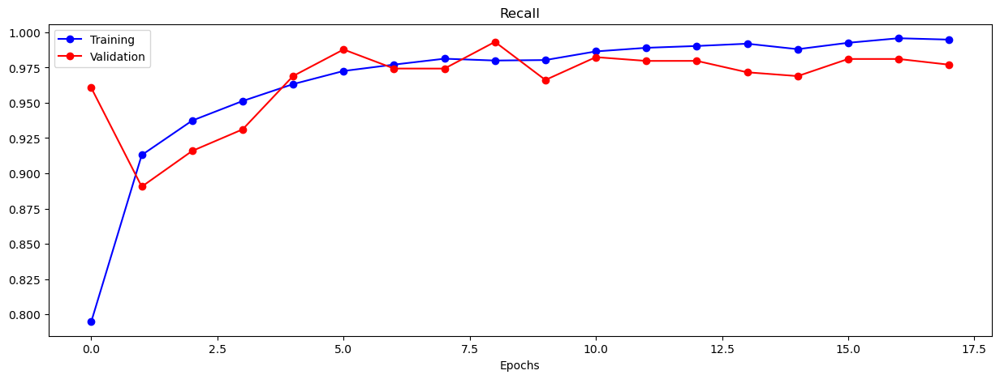

In [126]:
visualize_training_results(results_5)

In [127]:
# MAKE PREDICTIONS USING THE EVALUATION GENERATORS
preds_train_5 = cnn_5.predict(train_eval_generator, 
                           steps=(train_generator.n//BATCH_SIZE+1), 
                           verbose=1,
                           workers=8)
preds_val_5 = cnn_5.predict(val_eval_generator, 
                         steps=(val_generator.n//BATCH_SIZE+1),
                         verbose=1,
                         workers=8)

33/33 [==============================] - 2s 57ms/step


In [128]:
cnn_5_metrics = cnn_5.evaluate(val_eval_generator)
perf_df.loc[len(perf_df.index)] = ['cnn_5'] + cnn_5_metrics
perf_df

33/33 [==============================] - 7s 218ms/step - loss: 0.0782 - accuracy: 0.9675 - recall: 0.9749 - precision: 0.9801


,model,loss,accuracy,recall,precision
0,baseline,0.135636,0.966571,0.988111,0.966408
1,cnn_2,0.097508,0.965616,0.981506,0.971242
2,cnn_3,0.065743,0.973257,0.982827,0.980237
3,cnn_4,0.067421,0.971347,0.978864,0.981457
4,cnn_5,0.078174,0.967526,0.974901,0.980080


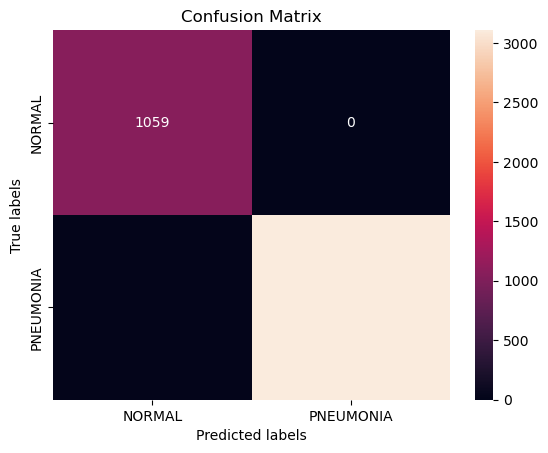

In [129]:
# PLOT CONFUSION MATRIX FOR TRAINING SET
# (converting predicted values from float to nearest integer)
plot_confusionmatrix(train_df['label'], np.rint(preds_train_5)) 

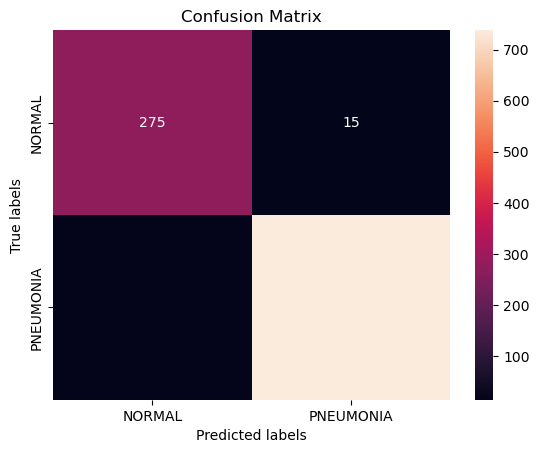

In [130]:
# PLOT CONFUSION MATRIX FOR VALIDATION SET
plot_confusionmatrix(val_df['label'], np.rint(preds_val_5))

In [131]:
# APPEND PREDICTIONS OF THE cnn_5 MODEL TO val_df FOR COMPARISON WITH
# OTHER MODELS LATER
val_df['cnn_5_pred'] = preds_val_5
val_df.head()

,image,label,type,baseline_pred,cnn_2_pred,cnn_3_pred,cnn_4_pred,cnn_5_pred
240,C:\Users\vedik\Downloads\archive (1)\chest_xra...,0,normal,0.082106,0.004165,0.000584,0.000050,0.000591
584,C:\Users\vedik\Downloads\archive (1)\chest_xra...,0,normal,0.082106,0.006905,0.000241,0.000027,0.002595
2259,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,bacteria,1.000000,0.999843,0.999947,0.999986,0.999299
1420,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,bacteria,1.000000,1.000000,1.000000,1.000000,1.000000
1835,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,bacteria,1.000000,0.999963,0.999986,0.999997,0.999890


In [132]:
# PNEUMONIA CASES THAT HAVE BEEN INCORRECTLY PREDICTED BY cnn_5
fn5 = val_df[(val_df.label - np.rint(val_df.cnn_5_pred)) == 1]
fn5

,image,label,type,baseline_pred,cnn_2_pred,cnn_3_pred,cnn_4_pred,cnn_5_pred
4431,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,virus,0.691472,0.677841,0.310703,0.341446,0.325246
4849,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,virus,0.916973,0.096904,0.559646,0.269886,0.485366
3226,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,virus,0.137641,0.059667,0.440725,0.292428,0.152905
3442,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,bacteria,0.499926,0.210230,0.340346,0.087276,0.218184
3247,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,virus,0.610895,0.888455,0.943667,0.907403,0.111009
3881,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,virus,0.732682,0.580454,0.960650,0.957070,0.274746
1351,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,bacteria,0.449593,0.835255,0.443359,0.219194,0.196380
3869,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,virus,0.082106,0.139956,0.437836,0.338730,0.054903
1374,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,virus,0.212132,0.086999,0.071287,0.022252,0.044749
1666,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,virus,0.886227,0.028001,0.468582,0.343539,0.409593


In [133]:
# PNEUMONIA CASES THAT HAVE BEEN INCORRECTLY PREDICTED BY 4 MODELS
# baseline, cnn_3, cnn_4 and cnn_5
fn_all = val_df[((val_df.label - np.rint(val_df.baseline_pred)) == 1) & \
                (np.rint(val_df.baseline_pred) == np.rint(val_df.cnn_5_pred)) & \
                (np.rint(val_df.baseline_pred) == np.rint(val_df.cnn_4_pred)) & \
                (np.rint(val_df.baseline_pred) == np.rint(val_df.cnn_3_pred))]
fn_all

,image,label,type,baseline_pred,cnn_2_pred,cnn_3_pred,cnn_4_pred,cnn_5_pred
3226,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,virus,0.137641,0.059667,0.440725,0.292428,0.152905
3442,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,bacteria,0.499926,0.210230,0.340346,0.087276,0.218184
1351,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,bacteria,0.449593,0.835255,0.443359,0.219194,0.196380
3869,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,virus,0.082106,0.139956,0.437836,0.338730,0.054903
1374,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,virus,0.212132,0.086999,0.071287,0.022252,0.044749
3697,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,bacteria,0.233396,0.121542,0.121893,0.028041,0.033574
2366,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,virus,0.143797,0.160385,0.246908,0.228443,0.223593
4921,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,virus,0.082106,0.008906,0.002666,0.000654,0.001673
3199,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,bacteria,0.316936,0.073294,0.327532,0.268770,0.123866


In [134]:
fn_generator = ImageDataGenerator(rescale=1.0/255).flow_from_dataframe(
    dataframe=fn_all, x_col='image', y_col='cnn_5_pred',
    class_mode='raw',
    color_mode='grayscale',
    target_size=(180,180), batch_size=BATCH_SIZE,
    shuffle=False
)

fn_images, fn_prob = next(fn_generator)

Found 9 validated image filenames.


PNEUMONIA cases predicted as NORMAL by all 4 models baseline, cnn_3, cnn_4, and cnn_5



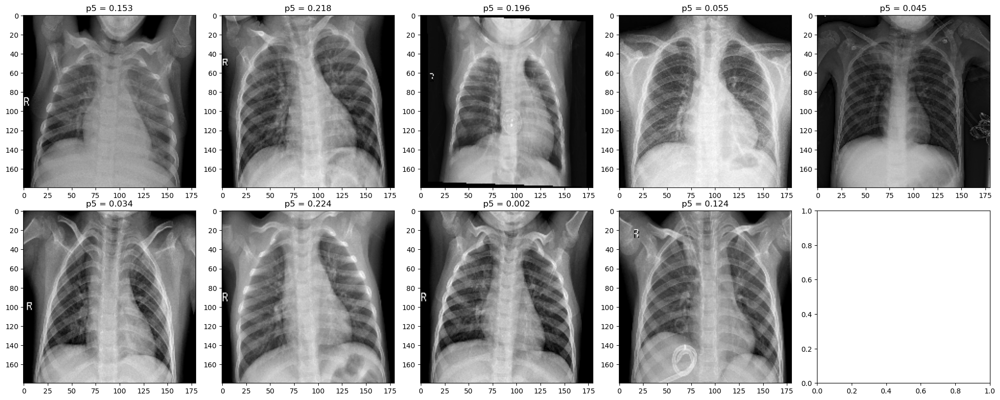

In [135]:
print('PNEUMONIA cases predicted as NORMAL by all 4 models baseline, cnn_3, cnn_4, and cnn_5')
print()
fig, axes = plt.subplots(nrows=2, ncols=5, figsize=(20,8))

for i in range(len(fn_all)):
    ax = axes[i // 5][i % 5]
    ax.imshow(fn_images[i], cmap='gray')
    ax.set_title('p5 = {:.3f}'.format(fn_prob[i]))

plt.tight_layout()
plt.show();

In [136]:
val_df[val_df.label==1].describe()

,label,baseline_pred,cnn_2_pred,cnn_3_pred,cnn_4_pred,cnn_5_pred
count,757.0,757.000000,757.000000,757.000000,757.000000,757.000000
mean,1.0,0.987382,0.972280,0.979463,0.977935,0.971095
std,0.0,0.088719,0.122092,0.100796,0.114151,0.129478
min,1.0,0.082106,0.008906,0.002666,0.000654,0.001673
25%,1.0,0.999996,0.997856,0.999207,0.999579,0.996448
50%,1.0,1.000000,0.999912,0.999916,0.999980,0.999650
75%,1.0,1.000000,0.999996,0.999989,0.999999,0.999952
max,1.0,1.000000,1.000000,1.000000,1.000000,1.000000


In [137]:
fn_all.describe()

,label,baseline_pred,cnn_2_pred,cnn_3_pred,cnn_4_pred,cnn_5_pred
count,9.0,9.000000,9.000000,9.000000,9.000000,9.000000
mean,1.0,0.239737,0.188470,0.270284,0.165087,0.116648
std,0.0,0.153225,0.249705,0.169208,0.130545,0.085567
min,1.0,0.082106,0.008906,0.002666,0.000654,0.001673
25%,1.0,0.137641,0.073294,0.121893,0.028041,0.044749
50%,1.0,0.212132,0.121542,0.327532,0.219194,0.123866
75%,1.0,0.316936,0.160385,0.437836,0.268770,0.196380
max,1.0,0.499926,0.835255,0.443359,0.338730,0.223593


In [138]:
perf_df

,model,loss,accuracy,recall,precision
0,baseline,0.135636,0.966571,0.988111,0.966408
1,cnn_2,0.097508,0.965616,0.981506,0.971242
2,cnn_3,0.065743,0.973257,0.982827,0.980237
3,cnn_4,0.067421,0.971347,0.978864,0.981457
4,cnn_5,0.078174,0.967526,0.974901,0.980080


In [139]:
# SAVE THE MODEL
cnn_5.save("cnn_5.h5")

In [140]:
# Reference: https://www.pyimagesearch.com/2018/12/24/how-to-use-keras-fit-and-fit_generator-a-hands-on-tutorial/

# CREATE AN AUGMENTATION GENERATOR FOR TRAINING DATASET
aug = ImageDataGenerator(rescale=1.0/255,
                         horizontal_flip=True,
                         rotation_range=10)

In [141]:
# CREATE NEW GENERATOR FOR TRAINING DATA (FROM train_df DATAFRAME)
aug_train_generator = aug.flow_from_dataframe(
    dataframe=train_df, x_col='image', y_col='label',
    color_mode='grayscale',
    class_mode='raw',
    target_size=(180,180), 
    batch_size=BATCH_SIZE,
    seed=42,
    shuffle=True   # shuffle so we're not missing out on any samples
)

Found 4185 validated image filenames.


In [142]:
images_train, labels_train = next(aug_train_generator)

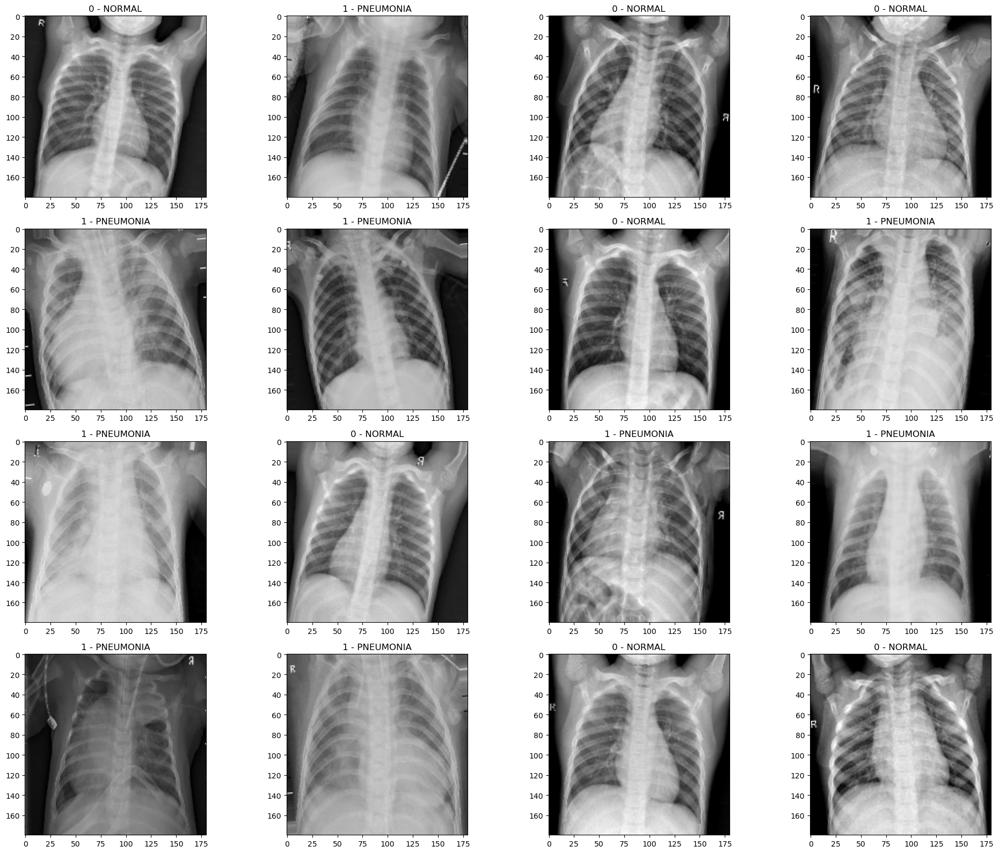

In [143]:
fig, axes = plt.subplots(nrows=4, ncols=4, figsize=(20,16))
label_output = {0: 'NORMAL', 1: 'PNEUMONIA'}
i = range(16)

for i in range(16):
    ax = axes[i // 4][i % 4]
    ax.imshow(images_train[i], cmap='gray')
    ax.set_title(f'{labels_train[i]} - {label_output[labels_train[i]]}')
    
plt.tight_layout()
plt.show();

In [144]:
# RECONSTRUCT cnn_5 WITH THE SAME ARCHITECTURE - called cnn_6
cnn_6 = Sequential()
cnn_6.add(Conv2D(32, (3,3), activation='relu', padding='same',
               input_shape=[180,180,1]))
cnn_6.add(MaxPooling2D(pool_size=(2,2)))
cnn_6.add(Flatten())
cnn_6.add(Dense(64, activation='relu'))
cnn_6.add(Dropout(0.3))
cnn_6.add(Dense(32, activation='relu'))
cnn_6.add(Dropout(0.3))
cnn_6.add(Dense(1, activation='sigmoid'))

In [145]:
cnn_6.compile(loss='binary_crossentropy',
                 optimizer='adam',
                 metrics=['accuracy', recall, precision])

cnn_6.summary()

Model: "sequential_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_7 (Conv2D)           (None, 180, 180, 32)      320       
                                                                 
 max_pooling2d_6 (MaxPoolin  (None, 90, 90, 32)        0         
 g2D)                                                            
                                                                 
 flatten_5 (Flatten)         (None, 259200)            0         
                                                                 
 dense_12 (Dense)            (None, 64)                16588864  
                                                                 
 dropout_2 (Dropout)         (None, 64)                0         
                                                                 
 dense_13 (Dense)            (None, 32)                2080      
                                                      

In [146]:
checkpoint_cb = ModelCheckpoint('cnn_6.h5',
                                save_best_only=True)
early_stopping_cb = EarlyStopping(patience=10,
                                  restore_best_weights=True)

BATCH_SIZE = 32
EPOCHS = 20

results_6 = cnn_6.fit(aug_train_generator, 
                      validation_data=val_generator,
                      epochs=EPOCHS,
                      class_weight=class_weight,
                      steps_per_epoch=(aug_train_generator.n//BATCH_SIZE),
                      validation_steps=(val_generator.n//BATCH_SIZE),
                      callbacks=[checkpoint_cb, early_stopping_cb])

Epoch 1/30
130/130 [==============================] - 68s 509ms/step - loss: 0.8421 - accuracy: 0.3990 - recall: 0.4364 - precision: 0.8269 - val_loss: 0.6925 - val_accuracy: 0.7236 - val_recall: 1.0000 - val_precision: 0.7236
Epoch 2/30
130/130 [==============================] - 63s 486ms/step - loss: 0.6953 - accuracy: 0.6022 - recall: 0.7190 - precision: 0.7405 - val_loss: 0.6928 - val_accuracy: 0.7236 - val_recall: 1.0000 - val_precision: 0.7236
Epoch 3/30
130/130 [==============================] - 64s 494ms/step - loss: 0.6930 - accuracy: 0.2591 - recall: 0.0197 - precision: 0.6354 - val_loss: 0.6933 - val_accuracy: 0.2783 - val_recall: 0.0000e+00 - val_precision: 0.0000e+00
Epoch 4/30
130/130 [==============================] - 64s 489ms/step - loss: 0.6921 - accuracy: 0.4195 - recall: 0.3334 - precision: 0.7529 - val_loss: 0.6918 - val_accuracy: 0.7256 - val_recall: 1.0000 - val_precision: 0.7256
Epoch 5/30
130/130 [==============================] - 64s 490ms/step - loss: 0.6932 

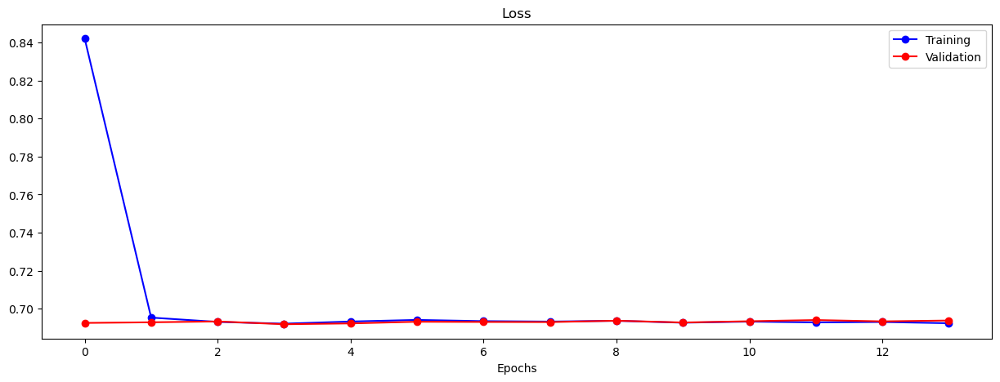

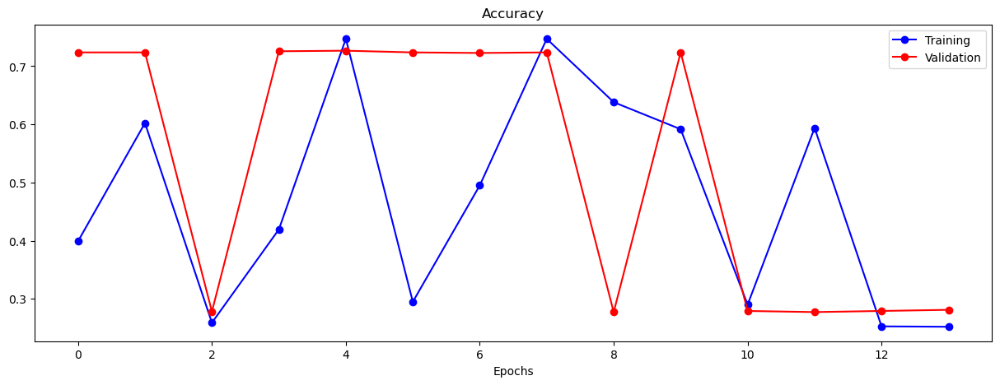

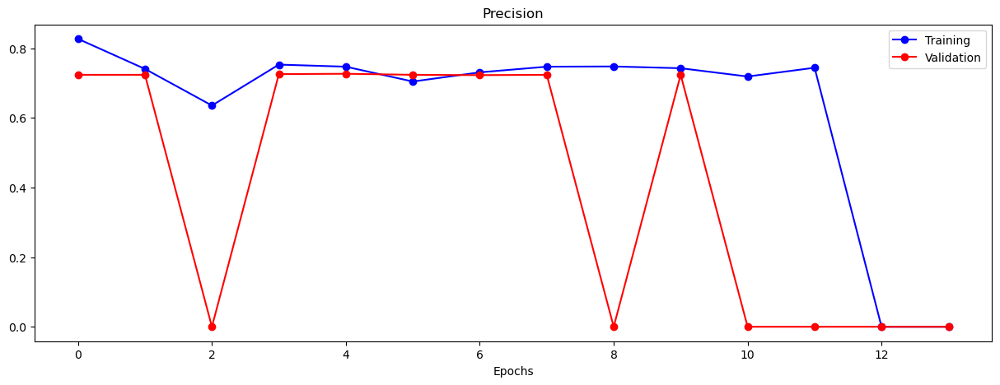

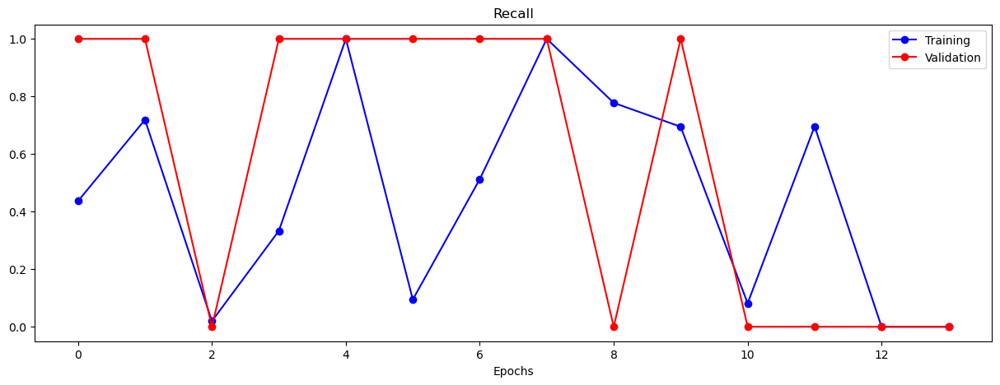

In [147]:
visualize_training_results(results_6)

In [148]:
train_eval_generator_aug = aug.flow_from_dataframe(
    dataframe=train_df, x_col='image', y_col='label',
    class_mode='raw',
    color_mode='grayscale',
    target_size=(180,180), 
    batch_size=BATCH_SIZE,
    seed=2021,
    shuffle=False     # not shuffle so that the predicts come out in the same order as in the original dataset
)

preds_train_6 = cnn_6.predict(train_eval_generator_aug, 
                                steps=(train_eval_generator_aug.n//BATCH_SIZE+1), 
                                verbose=1,
                                workers=8)
preds_val_6 = cnn_6.predict(val_eval_generator, 
                              steps=(val_eval_generator.n//BATCH_SIZE+1),
                              verbose=1,
                              workers=8)

Found 4185 validated image filenames.
33/33 [==============================] - 2s 49ms/step


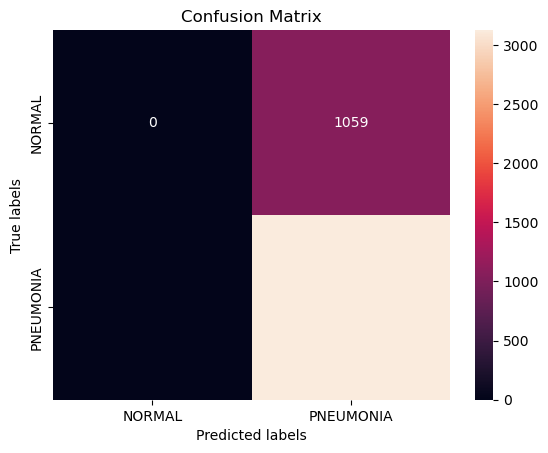

In [149]:
plot_confusionmatrix(train_df['label'], np.rint(preds_train_6))

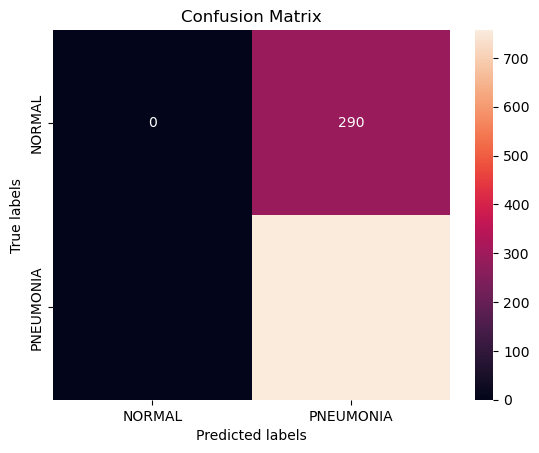

In [150]:
plot_confusionmatrix(val_df['label'], np.rint(preds_val_6)) 

In [151]:
cnn_6_metrics = cnn_6.evaluate(val_eval_generator)
perf_df.loc[len(perf_df.index)] = ['cnn_6'] + cnn_6_metrics
perf_df

33/33 [==============================] - 7s 202ms/step - loss: 0.6918 - accuracy: 0.7230 - recall: 1.0000 - precision: 0.7230


,model,loss,accuracy,recall,precision
0,baseline,0.135636,0.966571,0.988111,0.966408
1,cnn_2,0.097508,0.965616,0.981506,0.971242
2,cnn_3,0.065743,0.973257,0.982827,0.980237
3,cnn_4,0.067421,0.971347,0.978864,0.981457
4,cnn_5,0.078174,0.967526,0.974901,0.980080
5,cnn_6,0.691829,0.723018,1.000000,0.723018


In [152]:
# APPEND PREDICTIONS OF THE cnn_5 MODEL TO val_df FOR COMPARISON WITH
# OTHER MODELS LATER
val_df['cnn_6_pred'] = preds_val_6
val_df.head()

,image,label,type,baseline_pred,cnn_2_pred,cnn_3_pred,cnn_4_pred,cnn_5_pred,cnn_6_pred
240,C:\Users\vedik\Downloads\archive (1)\chest_xra...,0,normal,0.082106,0.004165,0.000584,0.000050,0.000591,0.501483
584,C:\Users\vedik\Downloads\archive (1)\chest_xra...,0,normal,0.082106,0.006905,0.000241,0.000027,0.002595,0.501483
2259,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,bacteria,1.000000,0.999843,0.999947,0.999986,0.999299,0.501483
1420,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,bacteria,1.000000,1.000000,1.000000,1.000000,1.000000,0.501483
1835,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,bacteria,1.000000,0.999963,0.999986,0.999997,0.999890,0.501483


In [153]:
# SAVE THE MODEL
cnn_6.save("cnn_6.h5")

In [154]:
test_df.sample(10, random_state=2021)

,image,label
285,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1
28,C:\Users\vedik\Downloads\archive (1)\chest_xra...,0
457,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1
286,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1
141,C:\Users\vedik\Downloads\archive (1)\chest_xra...,0
599,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1
269,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1
209,C:\Users\vedik\Downloads\archive (1)\chest_xra...,0
232,C:\Users\vedik\Downloads\archive (1)\chest_xra...,0
177,C:\Users\vedik\Downloads\archive (1)\chest_xra...,0


In [155]:
BATCH_SIZE = 32

test_generator = ImageDataGenerator(rescale=1.0/255).flow_from_dataframe(
    dataframe=test_df, x_col='image', y_col='label',
    class_mode='raw',
    color_mode='grayscale',
    target_size=(180,180), batch_size=BATCH_SIZE,
    seed=2021,
    shuffle=False
)

Found 624 validated image filenames.


In [156]:
master_generator = ImageDataGenerator(rescale=1.0/255).flow_from_dataframe(
    dataframe=master_df, x_col='image', y_col='label',
    class_mode='raw',
    color_mode='grayscale',
    target_size=(180,180), batch_size=BATCH_SIZE,
    seed=2021,
    shuffle=True
)

Found 5232 validated image filenames.


In [157]:
preds_test_6 = cnn_6.predict(test_generator, 
                             steps=(test_generator.n//BATCH_SIZE+1),
                             verbose=1,
                             workers=8)

20/20 [==============================] - 3s 116ms/step


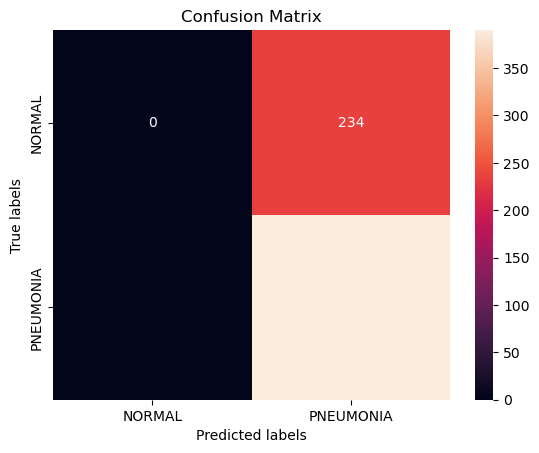

In [158]:
plot_confusionmatrix(test_df['label'], np.rint(preds_test_6)) 

In [159]:
cnn_6.evaluate(test_generator)

20/20 [==============================] - 3s 155ms/step - loss: 0.6924 - accuracy: 0.6250 - recall: 1.0000 - precision: 0.6250


[0.6924103498458862, 0.625, 1.0, 0.625]

In [160]:
from keras.applications.resnet50 import ResNet50

In [161]:
BATCH_SIZE = 32
IMG_SIZE = (224, 224)

# CREATE GENERATOR FOR TRAINING DATA (FROM train_df DATAFRAME)
resnet_train_generator = ImageDataGenerator(rescale=1.0/255).flow_from_dataframe(
    dataframe=train_df, x_col='image', y_col='label',
    color_mode='rgb',    # 3 channels
    class_mode='raw',
    target_size=IMG_SIZE, 
    batch_size=BATCH_SIZE,
    seed=42,
    shuffle=True   # shuffle so we're not missing out on any samples
)

# CREATE GENERATOR FOR VALIDATION DATA (FROM val_df DATAFRAME)
resnet_val_generator = ImageDataGenerator(rescale=1.0/255).flow_from_dataframe(
    dataframe=val_df, x_col='image', y_col='label',
    color_mode='rgb',    # 3 channels   
    class_mode='raw',
    target_size=IMG_SIZE, 
    batch_size=BATCH_SIZE,
    seed=42,
    shuffle=True
)

Found 4185 validated image filenames.
Found 1047 validated image filenames.


In [162]:
cnn_7 = Sequential()

# first layer would be NON-TRAINABLE (using pre-trained ResNet weights as is)
base_model = ResNet50(weights='imagenet',
                      include_top=False,
                      pooling='avg')
cnn_7.add(base_model)
cnn_7.add(Dense(1, activation='sigmoid'))

# freeze the weights of base model:
for layer in base_model.layers:
    layer.trainable = False

In [163]:
from keras.optimizers import SGD

In [172]:
# USING SGD TO CUSTOMIZE LEARNING RATE
sgd = SGD(lr=0.02, decay=0.01, momentum=0.9)
cnn_7.compile(optimizer=sgd, 
              loss='binary_crossentropy',
              metrics=['accuracy', recall, precision])
cnn_7.summary()

ValueError: decay is deprecated in the new Keras optimizer, please check the docstring for valid arguments, or use the legacy optimizer, e.g., tf.keras.optimizers.legacy.SGD.

In [173]:
checkpoint_cb = ModelCheckpoint('cnn_7.h5',
                                save_best_only=True,
                                monitor='val_loss',
                                mode='min')
early_stopping_cb = EarlyStopping(patience=3,
                                  restore_best_weights=True,
                                  monitor='val_loss',
                                  mode='min')

EPOCHS = 5

results_7 = cnn_7.fit(resnet_train_generator, 
                      validation_data=resnet_val_generator,
                      epochs=EPOCHS,
                      class_weight=class_weight,
                      steps_per_epoch=(resnet_train_generator.n//BATCH_SIZE),
                      validation_steps=(resnet_val_generator.n//BATCH_SIZE),
                      callbacks=[checkpoint_cb, early_stopping_cb])

RuntimeError: You must compile your model before training/testing. Use `model.compile(optimizer, loss)`.

In [174]:
# unfreeze base_model layers:
for layer in base_model.layers:
    layer.trainable = True

In [175]:
# REDUCING LEARNING RATE TO 0.01 TO AVOID DAMANGING THE PRETRAINED WEIGHTS
sgd = SGD(lr=0.01, decay=0.001, momentum=0.9)

# RE-COMPILE MODEL AFTER UNFREEZING ALL LAYERS
cnn_7.compile(optimizer=sgd, 
              loss='binary_crossentropy',
              metrics=['accuracy', recall, precision])

cnn_7.summary()

ValueError: decay is deprecated in the new Keras optimizer, please check the docstring for valid arguments, or use the legacy optimizer, e.g., tf.keras.optimizers.legacy.SGD.

In [176]:
checkpoint_cb = ModelCheckpoint('cnn_7.h5',
                                save_best_only=True,
                                monitor='val_loss',
                                mode='min')
early_stopping_cb = EarlyStopping(patience=10,
                                  restore_best_weights=True,
                                  monitor='val_loss',
                                  mode='min')

EPOCHS = 20

results_7 = cnn_7.fit(resnet_train_generator, 
                      validation_data=resnet_val_generator,
                      epochs=EPOCHS,
                      class_weight=class_weight,
                      steps_per_epoch=(resnet_train_generator.n//BATCH_SIZE),
                      validation_steps=(resnet_val_generator.n//BATCH_SIZE),
                      callbacks=[checkpoint_cb, early_stopping_cb])

RuntimeError: You must compile your model before training/testing. Use `model.compile(optimizer, loss)`.

In [177]:
visualize_training_results(results_7)

NameError: name 'results_7' is not defined

In [178]:
# CREATE GENERATOR FOR TRAINING DATA (FROM train_df DATAFRAME)
resnet_train_eval_generator = ImageDataGenerator(rescale=1.0/255).flow_from_dataframe(
    dataframe=train_df, x_col='image', y_col='label',
    color_mode='rgb',    # 3 channels
    class_mode='raw',
    target_size=IMG_SIZE, 
    batch_size=BATCH_SIZE,
    seed=42,
    shuffle=False   # shuffle so we're not missing out on any samples
)

# CREATE GENERATOR FOR VALIDATION DATA (FROM val_df DATAFRAME)
resnet_val_eval_generator = ImageDataGenerator(rescale=1.0/255).flow_from_dataframe(
    dataframe=val_df, x_col='image', y_col='label',
    color_mode='rgb',    # 3 channels   
    class_mode='raw',
    target_size=IMG_SIZE, 
    batch_size=BATCH_SIZE,
    seed=42,
    shuffle=False
)

preds_train_7 = cnn_7.predict(resnet_train_eval_generator, 
                                steps=(resnet_train_eval_generator.n//BATCH_SIZE+1), 
                                verbose=1,
                                workers=8)
preds_val_7 = cnn_7.predict(resnet_val_eval_generator, 
                              steps=(resnet_val_eval_generator.n//BATCH_SIZE+1),
                              verbose=1,
                              workers=8)

Found 4185 validated image filenames.
Found 1047 validated image filenames.
33/33 [==============================] - 56s 2s/step


In [179]:
cnn_7_metrics = cnn_7.evaluate(resnet_val_eval_generator)

RuntimeError: You must compile your model before training/testing. Use `model.compile(optimizer, loss)`.

In [180]:
perf_df.loc[len(perf_df.index)] = ['cnn_7'] + cnn_7_metrics
perf_df

NameError: name 'cnn_7_metrics' is not defined

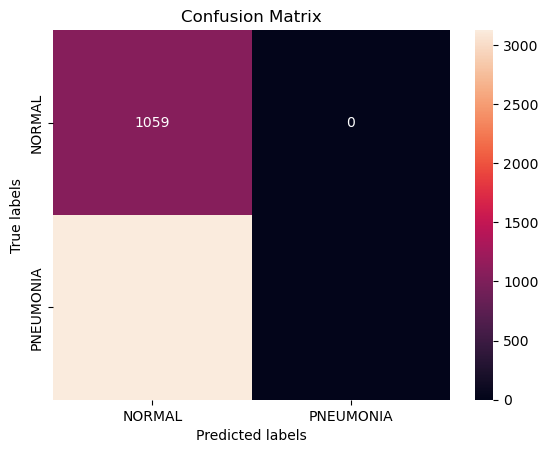

In [181]:
plot_confusionmatrix(train_df['label'], np.rint(preds_train_7))

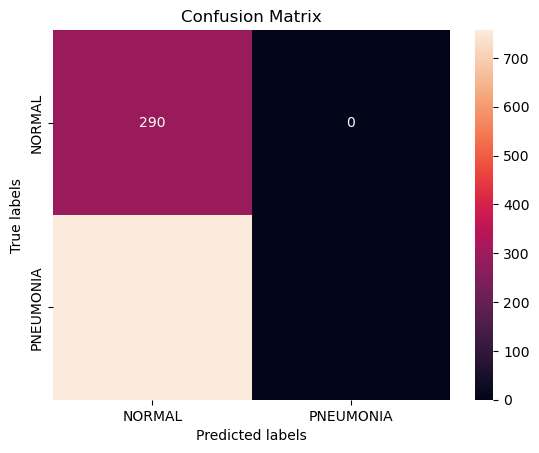

In [182]:
plot_confusionmatrix(val_df['label'], np.rint(preds_val_7))

In [183]:
# APPEND PREDICTIONS OF THE cnn_7 MODEL TO val_df FOR COMPARISON WITH
# OTHER MODELS LATER
val_df['cnn_7_pred'] = preds_val_7

In [184]:
val_df.head(10)

,image,label,type,baseline_pred,cnn_2_pred,cnn_3_pred,cnn_4_pred,cnn_5_pred,cnn_6_pred,cnn_7_pred
240,C:\Users\vedik\Downloads\archive (1)\chest_xra...,0,normal,0.082106,0.004165,0.000584,0.000050,0.000591,0.501483,0.301166
584,C:\Users\vedik\Downloads\archive (1)\chest_xra...,0,normal,0.082106,0.006905,0.000241,0.000027,0.002595,0.501483,0.302757
2259,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,bacteria,1.000000,0.999843,0.999947,0.999986,0.999299,0.501483,0.297976
1420,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,bacteria,1.000000,1.000000,1.000000,1.000000,1.000000,0.501483,0.302585
1835,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,bacteria,1.000000,0.999963,0.999986,0.999997,0.999890,0.501483,0.302304
80,C:\Users\vedik\Downloads\archive (1)\chest_xra...,0,normal,0.460352,0.802193,0.597325,0.291602,0.232852,0.501483,0.303386
3859,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,bacteria,1.000000,1.000000,0.999997,1.000000,0.999960,0.501483,0.306241
952,C:\Users\vedik\Downloads\archive (1)\chest_xra...,0,normal,0.082106,0.007652,0.000103,0.000015,0.001178,0.501483,0.306764
4431,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,virus,0.691472,0.677841,0.310703,0.341446,0.325246,0.501483,0.300964
1260,C:\Users\vedik\Downloads\archive (1)\chest_xra...,0,normal,0.082106,0.002705,0.001043,0.000117,0.002671,0.501483,0.309192


In [185]:
# SAVE MODEL 7
cnn_7.save("cnn_7.h5")

In [186]:
# PNEUMONIA CASES THAT HAVE BEEN INCORRECTLY PREDICTED BY cnn_7
fn7 = val_df[(val_df.label - np.rint(val_df.cnn_7_pred)) == 1]
fn7

,image,label,type,baseline_pred,cnn_2_pred,cnn_3_pred,cnn_4_pred,cnn_5_pred,cnn_6_pred,cnn_7_pred
2259,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,bacteria,1.000000,0.999843,0.999947,0.999986,0.999299,0.501483,0.297976
1420,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,bacteria,1.000000,1.000000,1.000000,1.000000,1.000000,0.501483,0.302585
1835,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,bacteria,1.000000,0.999963,0.999986,0.999997,0.999890,0.501483,0.302304
3859,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,bacteria,1.000000,1.000000,0.999997,1.000000,0.999960,0.501483,0.306241
4431,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,virus,0.691472,0.677841,0.310703,0.341446,0.325246,0.501483,0.300964
...,...,...,...,...,...,...,...,...,...,...
3995,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,bacteria,1.000000,0.999741,0.999972,0.999997,0.999844,0.501483,0.301651
1370,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,bacteria,1.000000,0.999941,0.999963,0.999994,0.999665,0.501483,0.302643
3113,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,bacteria,1.000000,0.999876,0.999989,0.999998,0.999965,0.501483,0.305148
5027,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,bacteria,1.000000,0.999996,0.999987,0.999997,0.999911,0.501483,0.303173


In [187]:
# PNEUMONIA CASES THAT HAVE BEEN INCORRECTLY PREDICTED BY 5 MODELS
# baseline, cnn_3, cnn_4, cnn_5, and cnn_7
fn_all = val_df[((val_df.label - np.rint(val_df.baseline_pred)) == 1) & \
                (np.rint(val_df.baseline_pred) == np.rint(val_df.cnn_7_pred)) & \
                (np.rint(val_df.baseline_pred) == np.rint(val_df.cnn_5_pred)) & \
                (np.rint(val_df.baseline_pred) == np.rint(val_df.cnn_4_pred)) & \
                (np.rint(val_df.baseline_pred) == np.rint(val_df.cnn_3_pred))]
fn_all

,image,label,type,baseline_pred,cnn_2_pred,cnn_3_pred,cnn_4_pred,cnn_5_pred,cnn_6_pred,cnn_7_pred
3226,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,virus,0.137641,0.059667,0.440725,0.292428,0.152905,0.501483,0.302191
3442,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,bacteria,0.499926,0.210230,0.340346,0.087276,0.218184,0.501483,0.299976
1351,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,bacteria,0.449593,0.835255,0.443359,0.219194,0.196380,0.501483,0.301070
3869,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,virus,0.082106,0.139956,0.437836,0.338730,0.054903,0.501483,0.302904
1374,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,virus,0.212132,0.086999,0.071287,0.022252,0.044749,0.501483,0.301848
3697,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,bacteria,0.233396,0.121542,0.121893,0.028041,0.033574,0.501483,0.310377
2366,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,virus,0.143797,0.160385,0.246908,0.228443,0.223593,0.501483,0.300073
4921,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,virus,0.082106,0.008906,0.002666,0.000654,0.001673,0.501483,0.309594
3199,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,bacteria,0.316936,0.073294,0.327532,0.268770,0.123866,0.501483,0.303040


In [188]:
# CREATE AN AUGMENTATION GENERATOR FOR TRAINING DATASET
aug = ImageDataGenerator(rescale=1.0/255,
                         horizontal_flip=True,
                         rotation_range=15)

BATCH_SIZE = 32
IMG_SIZE = (224, 224)

# CREATE GENERATOR FOR TRAINING DATA (FROM train_df DATAFRAME)
resnet_aug_train_generator = aug.flow_from_dataframe(
    dataframe=train_df, x_col='image', y_col='label',
    color_mode='rgb',    # 3 channels
    class_mode='raw',
    target_size=IMG_SIZE, 
    batch_size=BATCH_SIZE,
    seed=42,
    shuffle=True   # shuffle so we're not missing out on any samples
)

# CREATE GENERATOR FOR VALIDATION DATA (FROM val_df DATAFRAME)
resnet_val_generator = ImageDataGenerator(rescale=1.0/255).flow_from_dataframe(
    dataframe=val_df, x_col='image', y_col='label',
    color_mode='rgb',    # 3 channels   
    class_mode='raw',
    target_size=IMG_SIZE, 
    batch_size=BATCH_SIZE,
    seed=42,
    shuffle=True
)

Found 4185 validated image filenames.
Found 1047 validated image filenames.


In [189]:
images_train, labels_train = next(resnet_aug_train_generator)

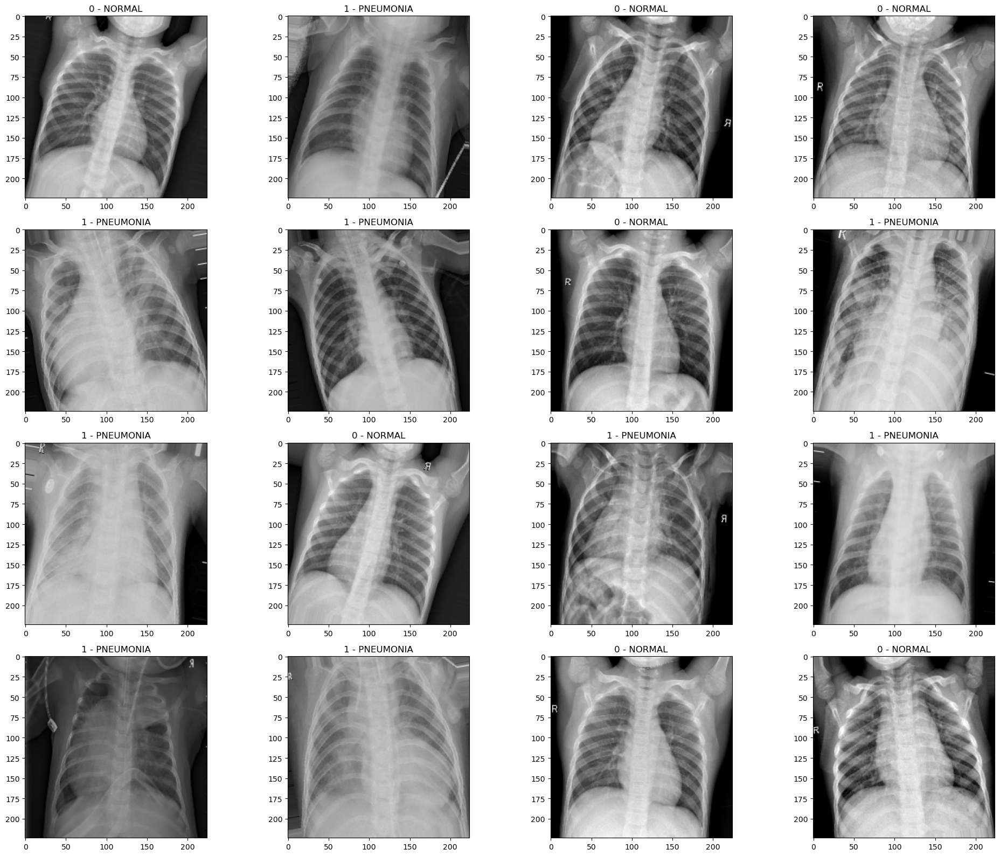

In [190]:
fig, axes = plt.subplots(nrows=4, ncols=4, figsize=(20,16))
label_output = {0: 'NORMAL', 1: 'PNEUMONIA'}
i = range(16)

for i in range(16):
    ax = axes[i // 4][i % 4]
    ax.imshow(images_train[i], cmap='gray')
    ax.set_title(f'{labels_train[i]} - {label_output[labels_train[i]]}')
    
plt.tight_layout()
plt.show();

In [191]:
cnn_8 = Sequential()

# first layer would be NON-TRAINABLE (using pre-trained ResNet weights as is)
base_model = ResNet50(weights='imagenet',
                      include_top=False,
                      pooling='avg')
cnn_8.add(base_model)
cnn_8.add(Dense(1, activation='sigmoid'))

# freeze the weights of base model:
for layer in base_model.layers:
    layer.trainable = False

In [192]:
# USING SGD TO CUSTOMIZE LEARNING RATE
sgd = SGD(lr=0.02, decay=0.01, momentum=0.9)
cnn_8.compile(optimizer=sgd, 
              loss='binary_crossentropy',
              metrics=['accuracy', recall, precision])
cnn_8.summary()

ValueError: decay is deprecated in the new Keras optimizer, please check the docstring for valid arguments, or use the legacy optimizer, e.g., tf.keras.optimizers.legacy.SGD.

In [196]:
checkpoint_cb = ModelCheckpoint('cnn_8.h5',
                                save_best_only=True,
                                monitor='val_loss',
                                mode='min')
early_stopping_cb = EarlyStopping(patience=3,
                                  restore_best_weights=True,
                                  monitor='val_loss',
                                  mode='min')

EPOCHS = 5

results_8 = cnn_8.fit(resnet_aug_train_generator, 
                      validation_data=resnet_val_generator,
                      epochs=EPOCHS,
                      class_weight=class_weight,
                      steps_per_epoch=(resnet_aug_train_generator.n//BATCH_SIZE),
                      validation_steps=(resnet_val_generator.n//BATCH_SIZE),
                      callbacks=[checkpoint_cb, early_stopping_cb])

RuntimeError: You must compile your model before training/testing. Use `model.compile(optimizer, loss)`.

In [197]:
# unfreeze base_model layers:
for layer in base_model.layers:
    layer.trainable = True

In [198]:
# REDUCING LEARNING RATE TO 0.01 TO AVOID DAMANGING THE PRETRAINED WEIGHTS
sgd = SGD(lr=0.01, decay=0.001, momentum=0.9)

# RE-COMPILE MODEL AFTER UNFREEZING ALL LAYERS
cnn_8.compile(optimizer=sgd, 
              loss='binary_crossentropy',
              metrics=['accuracy', recall, precision])

cnn_8.summary()

ValueError: decay is deprecated in the new Keras optimizer, please check the docstring for valid arguments, or use the legacy optimizer, e.g., tf.keras.optimizers.legacy.SGD.

In [199]:
checkpoint_cb = ModelCheckpoint('cnn_8.h5',
                                save_best_only=True,
                                monitor='val_loss',
                                mode='min')
early_stopping_cb = EarlyStopping(patience=10,
                                  restore_best_weights=True,
                                  monitor='val_loss',
                                  mode='min')

EPOCHS = 20

results_8 = cnn_8.fit(resnet_aug_train_generator, 
                      validation_data=resnet_val_generator,
                      epochs=EPOCHS,
                      class_weight=class_weight,
                      steps_per_epoch=(resnet_aug_train_generator.n//BATCH_SIZE),
                      validation_steps=(resnet_val_generator.n//BATCH_SIZE),
                      callbacks=[checkpoint_cb, early_stopping_cb])

RuntimeError: You must compile your model before training/testing. Use `model.compile(optimizer, loss)`.

In [200]:
visualize_training_results(results_8)

NameError: name 'results_8' is not defined

In [201]:
# CREATE GENERATOR FOR TRAINING DATA (FROM train_df DATAFRAME)
resnet_train_eval_generator = ImageDataGenerator(rescale=1.0/255).flow_from_dataframe(
    dataframe=train_df, x_col='image', y_col='label',
    color_mode='rgb',    # 3 channels
    class_mode='raw',
    target_size=IMG_SIZE, 
    batch_size=BATCH_SIZE,
    seed=42,
    shuffle=False   # shuffle so we're not missing out on any samples
)

# CREATE GENERATOR FOR VALIDATION DATA (FROM val_df DATAFRAME)
resnet_val_eval_generator = ImageDataGenerator(rescale=1.0/255).flow_from_dataframe(
    dataframe=val_df, x_col='image', y_col='label',
    color_mode='rgb',    # 3 channels   
    class_mode='raw',
    target_size=IMG_SIZE, 
    batch_size=BATCH_SIZE,
    seed=42,
    shuffle=False
)

preds_train_8 = cnn_8.predict(resnet_train_eval_generator, 
                                steps=(resnet_train_eval_generator.n//BATCH_SIZE+1), 
                                verbose=1,
                                workers=8)
preds_val_8 = cnn_8.predict(resnet_val_eval_generator, 
                              steps=(resnet_val_eval_generator.n//BATCH_SIZE+1),
                              verbose=1,
                              workers=8)

Found 4185 validated image filenames.
Found 1047 validated image filenames.
33/33 [==============================] - 55s 2s/step


In [195]:
cnn_8_metrics = cnn_8.evaluate(resnet_val_eval_generator)

RuntimeError: You must compile your model before training/testing. Use `model.compile(optimizer, loss)`.

In [193]:
plot_confusionmatrix(train_df['label'], np.rint(preds_train_8))

NameError: name 'preds_train_8' is not defined

In [194]:
plot_confusionmatrix(val_df['label'], np.rint(preds_val_8))

NameError: name 'preds_val_8' is not defined

In [202]:
# SAVE MODEL 7
cnn_8.save("cnn_8.h5")

In [203]:
# CREATE GENERATOR FOR VALIDATION DATA (FROM test_df DATAFRAME)
resnet_test_generator = ImageDataGenerator(rescale=1.0/255).flow_from_dataframe(
    dataframe=test_df, x_col='image', y_col='label',
    color_mode='rgb',    # 3 channels   
    class_mode='raw',
    target_size=IMG_SIZE, 
    batch_size=BATCH_SIZE,
    seed=42,
    shuffle=False
)

Found 624 validated image filenames.


In [204]:
preds_test_7 = cnn_7.predict(resnet_test_generator, 
                             steps=(resnet_test_generator.n//BATCH_SIZE+1),
                             verbose=1,
                             workers=8)

20/20 [==============================] - 34s 2s/step


In [205]:
cnn_7.evaluate(resnet_test_generator)

RuntimeError: You must compile your model before training/testing. Use `model.compile(optimizer, loss)`.

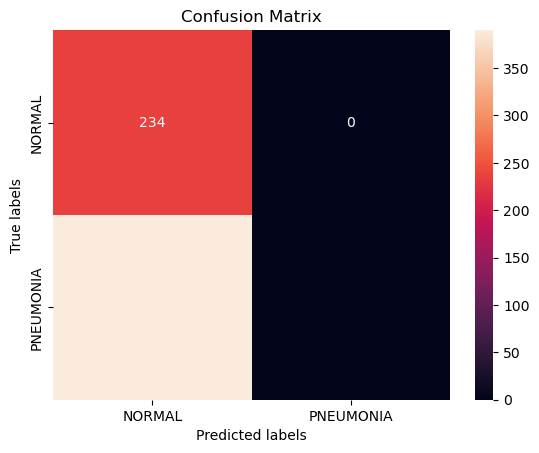

In [206]:
plot_confusionmatrix(test_df['label'], np.rint(preds_test_7))

In [207]:
# SAVE DATAFRAMES 
val_df.to_pickle('../working/val_df.pkl')
perf_df.to_pickle('../working/performance_df.pkl')

OSError: Cannot save file into a non-existent directory: '..\working'

In [209]:
test_df['preds'] = preds_test_7

In [210]:
test_df[(test_df.label - np.rint(test_df.preds)) == 1]

,image,label,preds
234,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,0.302382
235,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,0.299922
236,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,0.303877
237,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,0.301826
238,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,0.300122
...,...,...,...
619,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,0.299850
620,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,0.299816
621,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,0.304066
622,C:\Users\vedik\Downloads\archive (1)\chest_xra...,1,0.301963


In [211]:
test_df.to_pickle('../working/test_df.pkl')

OSError: Cannot save file into a non-existent directory: '..\working'

In [212]:
# TESTING cnn_8 ON TEST SET
cnn_8_metrics = cnn_8.evaluate(resnet_test_generator)

RuntimeError: You must compile your model before training/testing. Use `model.compile(optimizer, loss)`.

In [110]:
import numpy as np
from tensorflow.keras.preprocessing import image

def predict_image(img_path, model=cnn_3, target_size=(180, 180)):
    """
    Predict whether the image is Normal or Pneumonia using cnn_3 model.
    """
    # Load and preprocess image in grayscale
    img = image.load_img(img_path, target_size=target_size, color_mode='grayscale')
    img_array = image.img_to_array(img) / 255.0  # Normalize to [0, 1]
    img_array = np.expand_dims(img_array, axis=0)  # Shape: (1, 180, 180, 1)

    # Make prediction
    prediction = model.predict(img_array)[0][0]

    # Return result
    result = "Pneumonia" if prediction > 0.5 else "Normal"
    print(f"Prediction: {result} (Confidence: {prediction:.4f})")
    return result


In [111]:
# Your image path
img_path = r"C:\Users\vedik\Downloads\archive (1)\chest_xray\test\PNEUMONIA\person91_bacteria_447.jpeg"

# Predict using cnn_3 model
predict_image(img_path)


1/1 [==============================] - 0s 66ms/step
Prediction: Pneumonia (Confidence: 1.0000)


'Pneumonia'

In [112]:
# Your image path
img_path = r"C:\Users\vedik\OneDrive\Pictures\pneu.jpeg"

# Predict using cnn_3 model
predict_image(img_path)

1/1 [==============================] - 0s 33ms/step
Prediction: Pneumonia (Confidence: 1.0000)


'Pneumonia'

In [117]:
# Your image path
img_path = r"C:\Users\vedik\Downloads\archive (1)\chest_xray\train\NORMAL\NORMAL2-IM-1351-0001.jpeg"

# Predict using cnn_3 model
predict_image(img_path)

1/1 [==============================] - 0s 22ms/step
Prediction: Normal (Confidence: 0.0000)


'Normal'

In [122]:
# Your image path
img_path = r"C:\Users\vedik\Downloads\archive (1)\chest_xray\val\NORMAL\NORMAL2-IM-1437-0001.jpeg"

# Predict using cnn_3 model
predict_image(img_path)

1/1 [==============================] - 0s 23ms/step
Prediction: Pneumonia (Confidence: 0.5765)


'Pneumonia'